<a href="https://colab.research.google.com/github/AndreaViazzi/pimp/blob/main/clase_pimp.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Instalación e Importación de Paquetes**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
!pip install rasterio
!pip install numpy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.5/21.5 MB 53.2 MB/s eta 0:00:00


In [ ]:
import cv2
import numpy as np
import pandas as pd
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
import string
from matplotlib.colors import Normalize
import seaborn as sns

# **CLASE PROCESAMIENTO DE IMÁGENES DE PARCELAS - PIMP**

In [ ]:
class PIMP():

    """" Clase que permite procesar y analizar datos de imágenes multiespectrales"""

    def __init__(self,lista_rutas = None):
      f""" Método Constructor de la Clase PIMP

      Recibe
      ------

      lista_rutas : list
        Lista de cadena de caracteres representando la ubicación en el disco o memoria las
        4 bandas de interés (BLUE, RED, GREEN, NIR) de una o más imágenes.
        Ejemplo:

        Para una imagen:
        lista = ["/ubicacion/disco/imagenes/IMG_0000_"]

        Para varias:
        lista = ["/ubicacion/disco/imagenes/IMG_0000_",
                 "/ubicacion/disco/imagenes/IMG_0001_"]

      """

      for i in range(0,len(lista_rutas)):
          lista_rutas[i] = lista_rutas[i] + "{}.tif"
      self.lista_rutas = lista_rutas
      self.lista_imgs = []
      self.lista_imgs_alineadas = []

    def leer_bandas(self):
      f""" Método para cargar una sola imagen y sus bandas o varias imágenes con sus respectivas bandas

      Devuelve
      --------

      lista_imgs : list
        Lista que contiene una imagen y las cuatro bandas o va a contener todas las imágenes, donde cada
        posición de la lista tendrá los cuatro canales de esas imágenes
      """

      for i, ruta in enumerate(self.lista_rutas, start=1):
        canales = [cv2.imread(ruta.format(j), cv2.IMREAD_GRAYSCALE) for j in range(1, 5)]
        self.lista_imgs.append(canales)


    def alineacion_canales(self, numero_iteraciones = 5000, terminacion_eps = 1e-10):
      f"""Método de alineación de bandas de imágenes multiespectrales

          Recibe
          ------

          lst_imgs : list
            Lista con los cuatro canales de las imágenes. Se sugiere que el orden sea: RED, GREEN, BLUE, NIR

          numero_iteraciones : int
            Cantidad de iteraciones que tiene que hacer el algoritmo para estimar la transformación

          terminacion_eps : float
            Criterio de error para terminar la estimacion del algoritmo en caso que no converja


          Devuelve
          --------

          lista_imgs_alineadas : lst
            Va a tener la RED original y los demás canales alineados (GREEN, BLUE, NIR)
      """
      self.numero_iteraciones = numero_iteraciones
      self.terminacion_eps = terminacion_eps

      if self.numero_iteraciones > 0:

        try:

          for lst_imgs in self.lista_imgs:

            lst_imgs_alineadas = [lst_imgs[0]]
            sz = lst_imgs[0].shape
            warp_mode = cv2.MOTION_HOMOGRAPHY
            warp_matrix = np.eye(3, 3, dtype=np.float32)
            criteria = (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, self.numero_iteraciones,  self.terminacion_eps)
            (cc_rg, warp_matrix_rg) = cv2.findTransformECC (lst_imgs[0],lst_imgs[1],warp_matrix, warp_mode, criteria)
            lst_imgs_alineadas.append(cv2.warpPerspective(lst_imgs[1], warp_matrix_rg, (sz[1],sz[0]), flags=cv2.INTER_LINEAR + cv2.WARP_INVERSE_MAP));
            (cc_bg_a, warp_matrix_bg_a) = cv2.findTransformECC(lst_imgs_alineadas[1], lst_imgs[2], warp_matrix, warp_mode, criteria)
            lst_imgs_alineadas.append(cv2.warpPerspective(lst_imgs[2], warp_matrix_bg_a, (sz[1], sz[0]), flags=cv2.INTER_LINEAR + cv2.WARP_INVERSE_MAP))
            (cc_rn, warp_matrix_rn) = cv2.findTransformECC(lst_imgs[0], lst_imgs[3], warp_matrix, warp_mode, criteria)
            lst_imgs_alineadas.append(cv2.warpPerspective(lst_imgs[3], warp_matrix_rn, (sz[1], sz[0]), flags=cv2.INTER_LINEAR + cv2.WARP_INVERSE_MAP))
            self.lista_imgs_alineadas.append(lst_imgs_alineadas)

        except cv2.error as e:
          print("¡Error de convergencia!: Manipular numero_iteraciones o terminacion_eps")

      else:
        print("¡Número de iteraciones no puede ser 0 o negativo!")


    def composicion_rgb(self, tipo='cruda'):
      f"""Método para generar la composición RGB de las imágenes

      Devuelve
      --------

      lista_composicion : lista
          Lista que contiene en cada posición la composición RGB de la imagen o las imágenes cargadas o alineadas

      tipo : str
          Se podrá elegir cuál conjunto de imágenes componer:
            - 'cruda' para las imágenes cargadas
            - 'alineada' para las imágenes previamente alineadas
      """
      self.tipo = tipo
      self.lst_composicion_cruda = []
      self.lst_composicion_alineadas = []

      if (self.tipo == 'cruda') and (len(self.lista_imgs) > 0):
          for img in self.lista_imgs:
              self.lst_composicion_cruda.append(cv2.merge((img[0], img[1], img[2])))

      elif (self.tipo == 'alineada') and (len(self.lista_imgs_alineadas) > 0):
          for img in self.lista_imgs_alineadas:
              self.lst_composicion_alineadas.append(cv2.merge((img[0], img[1], img[2])))

      else:
          print('¡Revisar el tipo de composición requerida o la lista de imágenes llamada!')

    def calcular_ndvi_imagenes(self, tipo='alineada'):
        """
        Método para calcular el NDVI de las imágenes.

        Parámetros
        ----------
        tipo : str, opcional
            Tipo de imágenes para calcular el NDVI ('cruda' o 'alineada').

        Devuelve
        --------
        resultados_ndvi : list
            Lista que contiene los resultados del cálculo del NDVI para cada conjunto de imágenes.
        """
        self.resultados_ndvi = []

        if tipo == 'alineada' and self.lista_imgs_alineadas:
            lista_imagenes = self.lista_imgs_alineadas
        elif tipo == 'cruda' and self.lista_imgs:
            lista_imagenes = self.lista_imgs
        else:
            print(f"No se encontraron imágenes del tipo '{tipo}'.")
            return self.resultados_ndvi

        for conjunto in lista_imagenes:
            if tipo == 'cruda':
                banda_roja = np.array(conjunto[0]).astype(float)
                banda_nir = np.array(conjunto[3]).astype(float)
            elif tipo == 'alineada':
                banda_roja = np.array(conjunto[0]).astype(float)
                banda_nir = np.array(conjunto[3]).astype(float)
            else:
                print(f"Tipo de imágenes no válido: '{tipo}'.")
                return self.resultados_ndvi
            ndvi = (banda_nir - banda_roja) / (banda_nir + banda_roja)
            self.resultados_ndvi.append(ndvi)

        return self.resultados_ndvi

    def graficar_imagenes(self, num_filas, num_columnas, titulos, tipo='cruda'):
        """
        Método para graficar las imágenes almacenadas.

        Parámetros
        ----------
        num_filas : int
            Número de filas en el diseño de la figura a mostrar.
        num_columnas : int
            Número de columnas en el diseño de la figura a mostrar.
        titulos : list
            Lista de títulos para cada subfigura.
        tipo : str, opcional
            Tipo de imágenes a graficar ('cruda', 'alineada', 'ndvi').

        Devuelve
        --------
        None
        """
        if tipo == 'cruda' and self.lst_composicion_cruda:
            lista_imagenes = self.lst_composicion_cruda
        elif tipo == 'alineada' and self.lst_composicion_alineadas:
            lista_imagenes = self.lst_composicion_alineadas
        elif tipo == 'ndvi' and self.resultados_ndvi:
            lista_imagenes = self.resultados_ndvi
        else:
            print(f"No se encontraron imágenes del tipo '{tipo}'.")
            return

        num_imagenes = len(lista_imagenes)

        if num_imagenes == 0:
            print("No hay imágenes para graficar.")
            return

        if num_filas * num_columnas < num_imagenes:
            print("El diseño de la figura no es suficiente para todas las imágenes, modifica el número de filas o columnas.")
            return

        fig, axs = plt.subplots(num_filas, num_columnas, figsize=(12, 12))

        if num_filas == 1 and num_columnas == 1:
          if tipo == 'ndvi':
              axs.imshow(lista_imagenes[0], cmap='RdYlGn')
          else:
              axs.imshow((cv2.cvtColor(lista_imagenes[0], cv2.COLOR_BGR2RGB)))
          axs.axis('off')
          axs.set_title(titulos[0])
        elif num_filas == 1 or num_columnas == 1:
            for i in range(num_imagenes):
                if tipo == 'ndvi':
                    axs[i].imshow(lista_imagenes[i], cmap='RdYlGn')
                else:
                    axs[i].imshow((cv2.cvtColor(lista_imagenes[i], cv2.COLOR_BGR2RGB)))
                axs[i].axis('off')
                axs[i].set_title(titulos[i])
        else:
            for i in range(num_imagenes):
                fila = i // num_columnas
                col = i % num_columnas
                if tipo == 'ndvi':
                    axs[fila, col].imshow(lista_imagenes[i], cmap='RdYlGn')
                else:
                    axs[fila, col].imshow((cv2.cvtColor(lista_imagenes[i], cv2.COLOR_BGR2RGB)))
                axs[fila, col].axis('off')
                axs[fila, col].set_title(titulos[i])

        plt.show()

    def graficar_histobox_ndvi(self, titulos, num_filas=5, num_columnas=4, tipo_grafico='histograma'):
        f"""
        Método para graficar histogramas o boxplots de NDVI.

        Parámetros
        ----------
        resultados_ndvi : list
            Lista de NDVI calculado.
        titulos : list
            Títulos para cada recorte.
        num_filas : int, opcional
            Número de filas en la cuadrícula de ejes.
        num_columnas : int, opcional
            Número de columnas en la cuadrícula de ejes.
        tipo_grafico : str, opcional
            Tipo de gráfico a crear ('histograma' o 'boxplot').

        Devuelve
        --------
        None
        """

        resultados_ndvi = self.resultados_ndvi
        fig, axs = plt.subplots(num_filas, num_columnas)

        for i, resultado_ndvi in enumerate(resultados_ndvi):
            if num_filas == 1 and num_columnas == 1:

              if tipo_grafico == 'histograma':

                    n, bins, patches = axs.hist(
                        resultado_ndvi.ravel(), bins=50, color='#1f78b4', alpha=1, density=True
                    )
                    axs.set_title(titulos[i], fontsize=14, fontweight='bold')
                    axs.grid(False)
                    axs.set_xlim([min(bins), max(bins)])
                    axs.set_ylim([0, max(n)])
              elif tipo_grafico == 'boxplot':

                    bp = axs.boxplot([resultado_ndvi.flatten()], vert=False, patch_artist=True)
                    axs.set_title(titulos[i], fontsize=14, fontweight='bold')


              axs.tick_params(axis='x')
              axs.tick_params(axis='y')
              plt.sca(axs)
              plt.xticks(fontweight='bold', fontsize=14)
              plt.yticks(fontweight='bold', fontsize=14)


              plt.tight_layout()
              plt.show()

            elif (num_columnas == 1) or (num_filas == 1):
                if tipo_grafico == 'histograma':
                    n, bins, patches = axs[i].hist(
                        resultado_ndvi.ravel(), bins=50, color='#1f78b4', alpha=1, density=True
                    )
                    axs[i].set_title(titulos[i], fontsize=14, fontweight='bold')
                    axs[i].grid(False)
                    axs[i].set_xlim([min(bins), max(bins)])
                    axs[i].set_ylim([0, max(n)])
                elif tipo_grafico == 'boxplot':

                    bp = axs[i].boxplot([resultado_ndvi.flatten()], vert=False, patch_artist=True)
                    axs[i].set_title(titulos[i], fontsize=14, fontweight='bold')

                axs[i].tick_params(axis='x')
                axs[i].tick_params(axis='y')
                plt.sca(axs[i])
                plt.xticks(fontweight='bold', fontsize=14)
                plt.yticks(fontweight='bold', fontsize=14)

                plt.tight_layout()

            else:
                row = i // num_columnas if num_filas > 1 else 0
                col = i % num_columnas if num_columnas > 1 else 0
                ax = axs[row][col]

                if tipo_grafico == 'histograma':
                    n, bins, patches = ax.hist(
                        resultado_ndvi.ravel(), bins=50, color='#1f78b4', alpha=1, density=True
                    )
                    ax.set_title(titulos[i], fontsize=14, fontweight='bold')
                    ax.grid(False)
                    ax.set_xlim([min(bins), max(bins)])
                    ax.set_ylim([0, max(n)])
                elif tipo_grafico == 'boxplot':
                    bp = ax.boxplot([resultado_ndvi.flatten()], vert=False, patch_artist=True)
                    ax.set_title(titulos[i], fontsize=14, fontweight='bold')


                for row_axs in axs:
                    for ax in row_axs:
                        ax.tick_params(axis='x')
                        plt.sca(ax)
                        plt.xticks(fontweight='bold', fontsize=14)
                for row_axs in axs:
                    for ax in row_axs:
                        ax.tick_params(axis='y')
                        plt.sca(ax)
                        plt.yticks(fontweight='bold', fontsize=14)

                plt.tight_layout()


    def recortar_imagen(self, indice_imagen, coordenadas_recorte, tipo='cruda'):
        f"""
        Método para recortar una imagen específica en base a las coordenadas especificadas.

        Parámetros
        ----------
        indice_imagen : int
            Índice de la imagen a recortar.
        coordenadas_recorte : list
            Lista de tuplas que representan las coordenadas de recorte en el formato (x1, y1, x2, y2).
        tipo : str, opcional
            Tipo de imágenes a recortar ('cruda', 'alineada', 'ndvi').

        Devuelve
        --------
        parcelas : list
            Lista que contiene la imagen recortada según las coordenadas especificadas.
        """
        parcelas = []

        if tipo == 'cruda' and self.lst_composicion_cruda:
            lista_imagenes = self.lst_composicion_cruda
        elif tipo == 'alineada' and self.lst_composicion_alineadas:
            lista_imagenes = self.lst_composicion_alineadas
        elif tipo == 'ndvi' and self.resultados_ndvi:
            lista_imagenes = self.resultados_ndvi
        else:
            print(f"No se encontraron imágenes del tipo '{tipo}'.")
            return parcelas

        if 0 <= indice_imagen < len(lista_imagenes):
            img = lista_imagenes[indice_imagen]
            for coords in coordenadas_recorte:
                x1, y1, x2, y2 = coords
                zona_recortada = img[y1:y2, x1:x2]
                parcelas.append(zona_recortada)
        else:
            print(f"Índice de imagen no válido: {indice_imagen}.")

        return parcelas


    def grafica_parcelas(self, parcelas, titulos, tipo="rgb", num_filas=1, num_columnas=2, figsize=(12, 12)):
        """
        Método para graficar las parcelas.

        Parámetros
        ----------
        parcelas : list
            Lista que contiene las parcelas a graficar.
        titulos : list
            Lista de títulos para cada parcela.
        tipo : str, opcional
            Tipo de parcelas ('rgb' o 'ndvi').
        num_filas : int, opcional
            Número de filas en el diseño de la figura a mostrar.
        num_columnas : int, opcional
            Número de columnas en el diseño de la figura a mostrar.
        figsize : tuple, opcional
            Tamaño de la figura.

        Devuelve
        --------
        None
        """
        num_parcelas = len(parcelas)
        fig, axs = plt.subplots(num_filas, num_columnas, figsize=figsize)

        for i in range(num_parcelas):
            fila = i // num_columnas
            col = i % num_columnas
            if tipo == "ndvi":
                if isinstance(parcelas[i], np.ndarray):
                    axs[fila, col].imshow(parcelas[i], cmap='RdYlGn')
                else:
                    print("La parcela no es un array NumPy, no se puede visualizar como NDVI.")
            else:
                axs[fila, col].imshow(parcelas[i], cmap='gray')
            axs[fila, col].axis('off')
            axs[fila, col].set_title(titulos[i])

        plt.show()

    def filtrar_pixeles(self, lista_imagenes_ndvi, umbral=0.2, x=None, y=None):
        """
        Método para filtrar los píxeles con un valor NDVI mayor que el umbral dado y calcular estadísticas adicionales.

        Parámetros
        ----------
        lista_imagenes_ndvi : list
            Lista de imágenes NDVI.
        umbral : float
            Umbral para filtrar los píxeles. Por defecto, es 0.2.
        variables_extra_1 : list
            Lista de valores para la variable extra 1 (x). La longitud debe ser igual a la cantidad de imágenes NDVI.
        variables_extra_2 : list
            Lista de valores para la variable extra 2 (y). La longitud debe ser igual a la cantidad de imágenes NDVI.

        Devuelve
        --------
        df_resultados : pandas.DataFrame
            DataFrame que contiene la cantidad de píxeles filtrados y estadísticas adicionales para cada imagen NDVI.
        """
        resultados_filtrados = []

        for i, imagen_ndvi in enumerate(lista_imagenes_ndvi, 1):
            pixeles_filtrados = imagen_ndvi[imagen_ndvi > umbral]
            cantidad_pixeles = len(pixeles_filtrados)
            media_pixeles = np.mean(pixeles_filtrados)
            desviacion_absoluta_media = np.mean(np.absolute(pixeles_filtrados - media_pixeles))
            resultados_filtrados.append((i, cantidad_pixeles, media_pixeles, desviacion_absoluta_media))


        df_resultados = pd.DataFrame(resultados_filtrados, columns=['Indice', 'Cantidad_Pixeles_Mayor_0.2', 'Media_Pixeles_Mayor_0.2', 'Desviacion_Absoluta_Media'])
        df_resultados.set_index('Indice', inplace=True)

        if x is not None:
            df_resultados['Variable_X'] = x
        else:
            df_resultados['Variable_X'] = np.nan

        if y is not None:
            df_resultados['Variable_Y'] = y
        else:
            df_resultados['Variable_Y'] = np.nan

        return df_resultados
    def graficar_correlacion(self, df):
            """
            Método para generar y graficar la matriz de correlación entre las variables del DataFrame.

            Parámetros
            ----------
            df : pandas.DataFrame
                DataFrame con las variables para calcular la correlación.
            """
            matriz_correlacion = df.corr()

            heatmap = sns.heatmap(matriz_correlacion, annot=True, cmap='coolwarm', fmt=".2f", square=True,
                                  xticklabels=matriz_correlacion.columns, yticklabels=matriz_correlacion.columns,
                                  annot_kws={'weight': 'bold', 'size': 14})

            heatmap.set_xticklabels(heatmap.get_xticklabels(), fontweight='bold', fontsize=11.5)
            heatmap.set_yticklabels(heatmap.get_yticklabels(), fontweight='bold', fontsize=11.5)

            plt.savefig("corr.svg", format="svg", bbox_inches='tight', pad_inches=0)

            plt.show()

# **Ejecución de clase PIMP**

# **Pocedimiento para varias imagenes desalineadas**

Se crea una instancia de la clase PIMP con una lista de rutas de archivos como parámetro de inicialización, lo primero que se debe garantizar antes de ejecutar este código, es tener las imágenes disponibles en las rutas especificadas en la lista $\texttt{rutas_archivos}$. Estas rutas deben ser accesibles desde la ubicación en la que se está ejecutando el código, ya sea a través de Google Drive o de manera local en la sesión de Google Colab.


In [ ]:
rutas_archivos = [
    "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_02_03/IMG_0008_",
    "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_02_08/IMG_0006_",
   "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_02_15/IMG_0010_",
    "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_02_22/IMG_0010_",
   "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_02_24/IMG_0006_",
    "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_03_01/IMG_0000_",
    "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_03_03/IMG_0001_",
    "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_03_10/IMG_0019_",
    "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_03_17/IMG_0009_",
    "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_03_22/IMG_0006_",
    "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_03_27/IMG_0000_",
     "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_03_29/IMG_0006_"
]
pimp = PIMP(lista_rutas=rutas_archivos)

El método  $\texttt{leer_bandas}$  se utiliza para cargar las imágenes y sus respectivas bandas.

Para que funcione correctamente no se necesita ningún parámetro específico, ya que utiliza las rutas de las imágenes previamente definidas en la instancia de la clase PIMP durante la inicialización.

Cuando se llama a este método, recorre la lista de rutas de imágenes almacenadas en  $\texttt{self.lista_rutas}$ , carga cada imagen y lee sus cuatro bandas (azul, rojo, verde y NIR) utilizando la biblioteca OpenCV ($\texttt{cv2.imread}$) con el flag  $\texttt{cv2.IMREAD_GRAYSCALE}$  para cargar las imágenes en escala de grises.

Después de cargar las bandas de cada imagen, las almacena en la lista $\texttt{self.lista_imgs}$, donde cada elemento de la lista es una lista que contiene las cuatro bandas correspondientes a una imagen.

In [ ]:
pimp.leer_bandas()

## Composiciones RGB

El método $\texttt{composicion_rgb}$ se utiliza para generar la composición RGB de las imágenes almacenadas en la instancia de la clase PIMP.


Para que funcione, se necesita el parámetro:

*   $\texttt{tipo}$: Especifica el tipo de imágenes que se utilizarán para generar la composición RGB.
En este caso, se ha especificado "cruda" para usar las imágenes originales.

El método recorre las imágenes cargadas y, para cada una de ellas realiza la composición RGB. Luego guarda cada composición en una lista correspondiente ($\texttt{lst_composicion_cruda}$).

In [ ]:
pimp.composicion_rgb(tipo="cruda")

El método $\texttt{graficar_imagenes}$ se utiliza para graficar las imágenes almacenadas en la instancia de la clase PIMP.

Para que funcione, se necesitan los siguientes parámetros:

*   $\texttt{num_filas}$: El número de filas en el diseño de la figura que se mostrará.
*   $\texttt{num_columnas}$: El número de columnas en el diseño de la figura que se mostrará.
*   $\texttt{titulos}$: Una lista de títulos para cada imagen que se va a graficar.
*   $\texttt{tipo}$: El tipo de imágenes que se van a graficar. En este caso, se ha especificado "cruda" para usar las imágenes originales sin procesar.

Se debe tener en cuenta que el número de filas y columnas dependerá de las imágenes a mostrar, en el siguiente ejemplo se especifica 4 filas y 3 columnas, lo que indica que se mostrarán 12 imágenes (el total cargado en la inicialización), también se deben asegurar los títulos correspondientes a cada imagen, coincidiendo con la cantidad establecida.


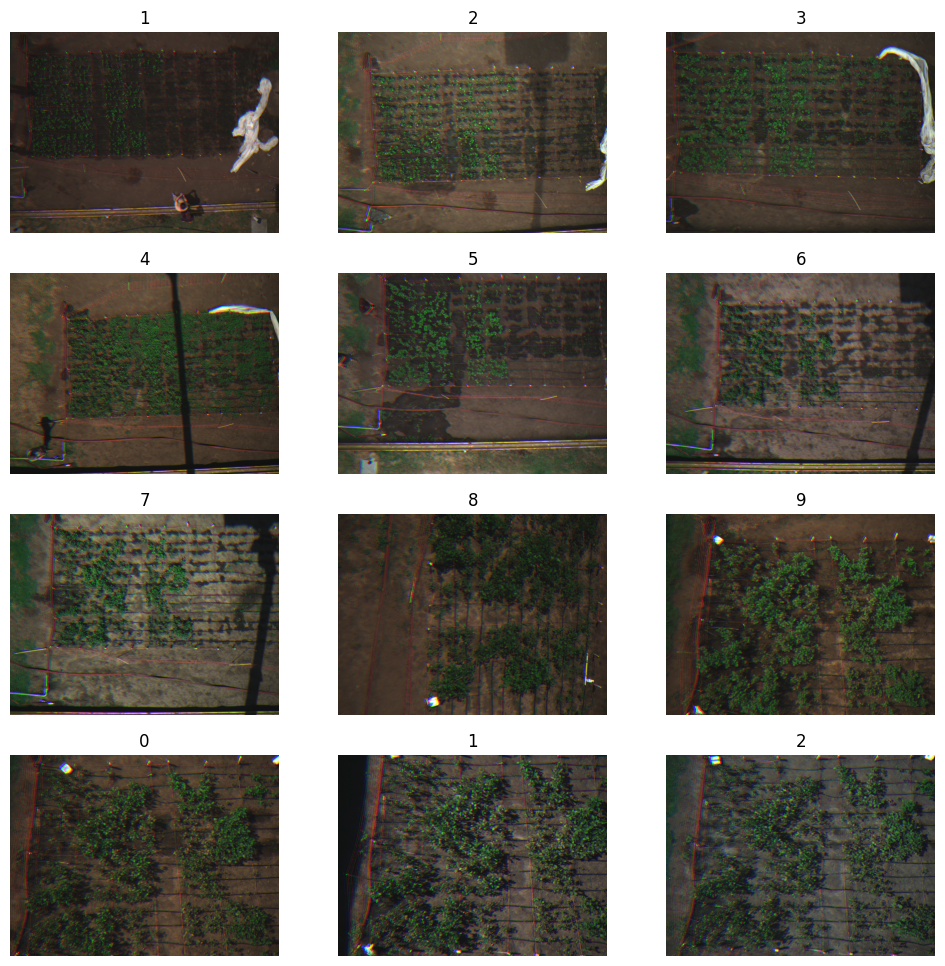

In [ ]:
titulos = [1,2,3,4,5,6,7,8,9,0,1,2]
pimp.graficar_imagenes(num_filas= 4, num_columnas= 3, titulos= titulos ,tipo="cruda")

## Cálculos de NDVI

El método $\texttt{calcular_ndvi_imagenes}$ se encarga de calcular el Índice de Vegetación de Diferencia Normalizada (NDVI) para las imágenes almacenadas en la instancia de la clase PIMP.

Para que funcione, se necesita especificar el tipo de imágenes que se van a utilizar para el cálculo del NDVI. En este caso, se ha proporcionado "cruda", lo que indica que se utilizarán las imágenes originales sin ningún tipo de procesamiento adicional.

El resultado es una lista que contiene los NDVI calculados en este caso es uno por ser una imágen, que se almacena en el atributo $\texttt{resultados_ndvi}$.

In [ ]:
pimp.calcular_ndvi_imagenes(tipo="cruda")

[array([[0.45054945, 0.33333333, 0.48837209, ..., 0.225     , 0.18987342,
         0.18918919],
        [0.46666667, 0.5257732 , 0.48837209, ..., 0.2195122 , 0.21518987,
         0.26829268],
        [0.38095238, 0.38461538, 0.41772152, ..., 0.26190476, 0.23809524,
         0.23076923],
        ...,
        [0.0625    , 0.10743802, 0.06976744, ..., 0.28712871, 0.32692308,
         0.32075472],
        [0.08943089, 0.16949153, 0.0625    , ..., 0.26126126, 0.26785714,
         0.31428571],
        [0.10569106, 0.1147541 , 0.06153846, ..., 0.26785714, 0.25217391,
         0.30434783]]),
 array([[ 0.17741935,  0.21052632,  0.27118644, ...,  0.07368421,
          0.08910891,  0.07843137],
        [ 0.17647059,  0.23076923,  0.26865672, ...,  0.07368421,
          0.03092784,  0.06666667],
        [ 0.1627907 ,  0.25984252,  0.36134454, ...,  0.1       ,
          0.04      ,  0.04761905],
        ...,
        [-0.40487805, -0.51239669, -0.42574257, ...,  0.18110236,
          0.15151515,  0

El método $\texttt{graficar_imagenes}$ se encarga de visualizar las imágenes almacenadas en la lista $\texttt{lista_imagenes}$, ya sea que estas sean imágenes RGB o imágenes del NDVI.

Para que funcione, se necesitan los siguientes elementos:
* $\texttt{num_filas}$ y $\texttt{num_columnas}$: Estos parámetros determinan la disposición de las imágenes en la figura que se mostrará.
* $\texttt{titulos}$: El parámetro titulos espera una lista de títulos para cada subfigura.
* $\texttt{tipo}$: El parámetro tipo indica qué tipo de imágenes se van a graficar. En este caso, se especifica 'ndvi', lo que significa que se espera graficar imágenes del Índice de Vegetación de Diferencia Normalizada.

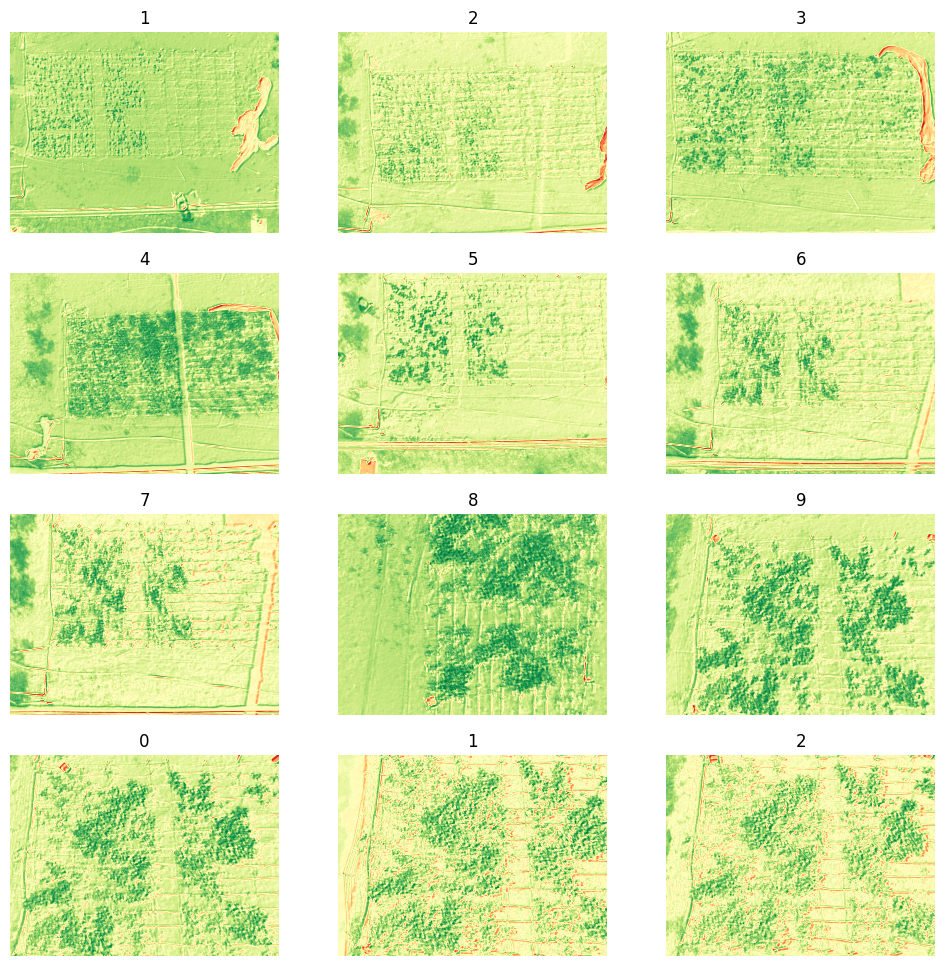

In [ ]:
titulos = [1,2,3,4,5,6,7,8,9,0,1,2]
pimp.graficar_imagenes(num_filas= 4, num_columnas= 3, titulos= titulos,tipo="ndvi")

# **Pocedimiento para varias imagenes alineadas**

Se crea una instancia de la clase PIMP con una lista de rutas de archivos como parámetro de inicialización, lo primero que se debe garantizar antes de ejecutar este código, es tener las imágenes disponibles en las rutas especificadas en la lista $\texttt{rutas_archivos}$. Estas rutas deben ser accesibles desde la ubicación en la que se está ejecutando el código, ya sea a través de Google Drive o de manera local.


In [ ]:
rutas_archivos = [
    "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_02_03/IMG_0008_",
    "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_02_08/IMG_0006_",
   "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_02_15/IMG_0010_",
    "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_02_22/IMG_0010_",
   "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_02_24/IMG_0006_",
    "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_03_01/IMG_0000_",
    "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_03_03/IMG_0001_",
    "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_03_10/IMG_0019_",
    "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_03_17/IMG_0009_",
    "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_03_22/IMG_0006_",
    "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_03_27/IMG_0000_",
     "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_03_29/IMG_0006_"
]
pimp = PIMP(lista_rutas=rutas_archivos)

El método  $\texttt{leer_bandas}$  se utiliza para cargar las imágenes y sus respectivas bandas.

Para que funcione correctamente no se necesita ningún parámetro específico, ya que utiliza las rutas de las imágenes previamente definidas en la instancia de la clase PIMP durante la inicialización.

Cuando se llama a este método, recorre la lista de rutas de imágenes almacenadas en  $\texttt{self.lista_rutas}$ , carga cada imagen y lee sus cuatro bandas (azul, rojo, verde y NIR) utilizando la biblioteca OpenCV ($\texttt{cv2.imread}$) con el flag  $\texttt{cv2.IMREAD_GRAYSCALE}$  para cargar las imágenes en escala de grises.

Después de cargar las bandas de cada imagen, las almacena en la lista $\texttt{self.lista_imgs}$, donde cada elemento de la lista es una lista que contiene las cuatro bandas correspondientes a una imagen.

In [ ]:
pimp.leer_bandas()

## Alineación de canales

El metodo $\texttt{self.alineacion_canales}$ se utiliza para alinear las bandas de imágenes multiespectrales. Este método realiza un proceso de alineación de las bandas utilizando la banda roja como referencia y ajustando las demás bandas (verde, azul y NIR) para que coincidan con esta. Utiliza un algoritmo de alineación basado en la maximización del coeficiente de correlación mejorado (ECC) para encontrar las mejores transformaciones que alineen las bandas verde, azul y NIR con la banda roja.

Necesita el parámetro $\texttt{numero_iteraciones}$ que indica la cantidad de iteraciones que el algoritmo debe realizar para optimizar la alineación. En este caso, `numero_iteraciones` está establecido en 50, puede ajustarse aumentando o disminuyendo este valor para obtener resultados más precisos o acelerar el proceso según las necesidades específicas del análisis.

Al terminar las iamgenes alineadas se almacenaran en una lista `lista_imgs_alineadas`.


In [ ]:
pimp.alineacion_canales(numero_iteraciones = 50)

## Composiciones RGB

El método $\texttt{composicion_rgb}$ se utiliza para generar la composición RGB de las imágenes almacenadas en la instancia de la clase PIMP.

Para que funcione, se necesita el parámetro:

*   $\texttt{tipo}$: Especifica el tipo de imágenes que se utilizarán para generar la composición RGB.
En este caso, se ha especificado "alineada" para usar las imágenes originales.

El método recorre las imágenes cargadas y, para cada una de ellas realiza la composición RGB. Luego guarda cada composición en una lista correspondiente ($\texttt{lst_composicion_alineada}$).

In [ ]:
pimp.composicion_rgb(tipo="alineada")

El método $\texttt{graficar_imagenes}$ se utiliza para graficar las imágenes almacenadas en la instancia de la clase PIMP.

Para que funcione, se necesitan los siguientes parámetros:

*   $\texttt{num_filas}$: El número de filas en el diseño de la figura que se mostrará.
*   $\texttt{num_columnas}$: El número de columnas en el diseño de la figura que se mostrará.
*   $\texttt{títulos}$: Una lista de títulos para cada imagen que se va a graficar.
*   $\texttt{tipo}$: El tipo de imágenes que se van a graficar. En este caso, se ha especificado "alineada" para usar las imágenes con sus bandas ajustadas en superposición.

Se debe tener en cuenta que el número de filas y columnas dependerá de las imágenes a mostrar, en el siguiente ejemplo se especifica 4 filas y 3 columnas, lo que indica que se mostrarán 12 imágenes (el total cargado en la inicialización), también se deben asegurar los títulos correspondientes a cada imagen, coincidiendo con la cantidad establecida.

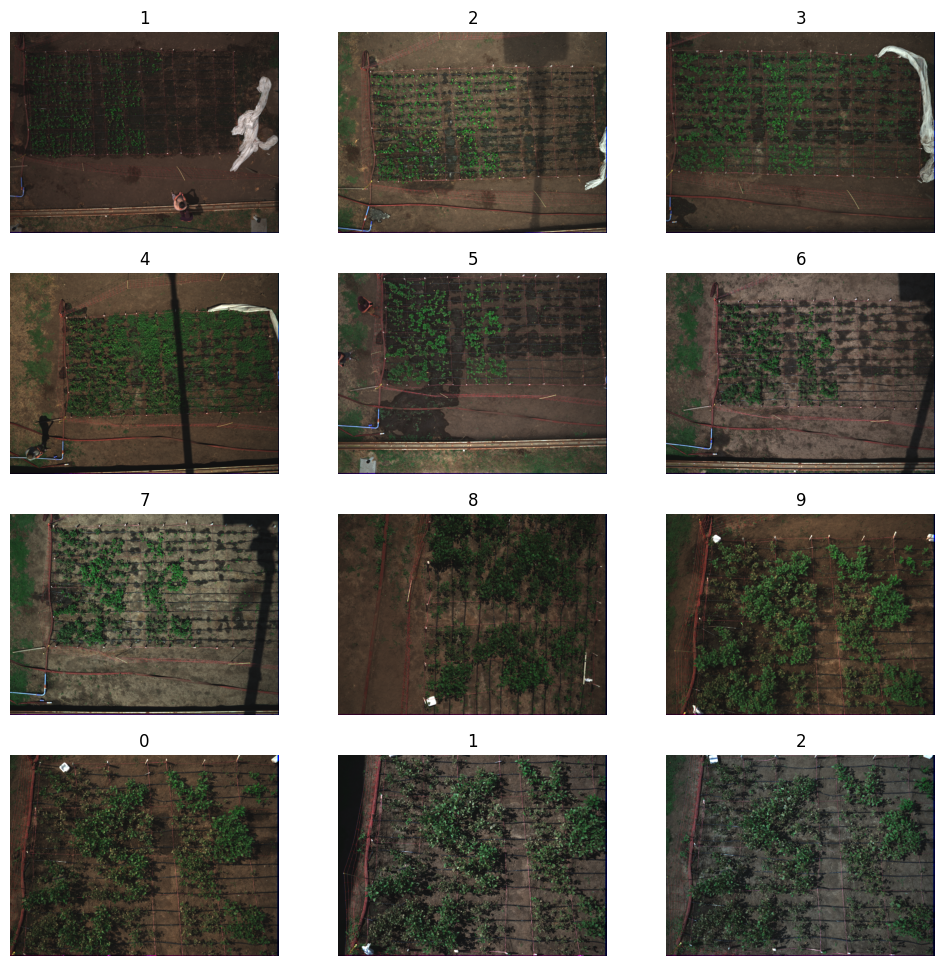

In [ ]:
titulos = [1,2,3,4,5,6,7,8,9,0,1,2]
pimp.graficar_imagenes(num_filas= 4, num_columnas= 3, titulos= titulos ,tipo="alineada")

## Cálculos de NDVI

El método $\texttt{calcular_ndvi_imagenes}$ se encarga de calcular el Índice de Vegetación de Diferencia Normalizada (NDVI) para las imágenes almacenadas en la instancia de la clase PIMP.

Para que funcione, se necesita especificar el tipo de imágenes que se van a utilizar para el cálculo del NDVI. En este caso, se ha proporcionado "alineada", lo que indica que se utilizarán las imágenes anteriormente ajustadas.

El resultado es una lista que contiene los NDVI calculados en este caso es uno por ser una imagen, que se almacena en el atributo $\texttt{resultados_ndvi}$.

In [ ]:
pimp.calcular_ndvi_imagenes(tipo="alineada")

[array([[ 0.375     ,  0.38271605,  0.45679012, ..., -1.        ,
         -1.        , -1.        ],
        [ 0.29113924,  0.37837838,  0.38888889, ..., -1.        ,
         -1.        , -1.        ],
        [ 0.36585366,  0.31707317,  0.35211268, ..., -1.        ,
         -1.        , -1.        ],
        ...,
        [-1.        , -1.        , -1.        , ..., -1.        ,
         -1.        , -1.        ],
        [-1.        , -1.        , -1.        , ..., -1.        ,
         -1.        , -1.        ],
        [-1.        , -1.        , -1.        , ..., -1.        ,
         -1.        , -1.        ]]),
 array([[ 0.23308271,  0.30769231,  0.35820896, ..., -1.        ,
         -1.        , -1.        ],
        [ 0.1884058 ,  0.32835821,  0.29496403, ..., -1.        ,
         -1.        , -1.        ],
        [ 0.22302158,  0.32374101,  0.4015748 , ..., -1.        ,
         -1.        , -1.        ],
        ...,
        [-1.        , -1.        , -1.        , ..., -

El método $\texttt{graficar_imagenes}$ se encarga de visualizar las imágenes almacenadas en la lista $\texttt{lista_imagenes}$, ya sea que estas sean imágenes RGB o imágenes del NDVI.

Para que funcione, se necesitan los siguientes elementos:
* $\texttt{num_filas}$ y $\texttt{num_columnas}$: Estos parámetros determinan la disposición de las imágenes en la figura que se mostrará.
* $\texttt{titulos}$: El parámetro titulos espera una lista de títulos para cada subfigura.
* $\texttt{tipo}$: El parámetro tipo indica qué tipo de imágenes se van a graficar. En este caso, se especifica 'ndvi', lo que significa que se espera graficar imágenes del Índice de Vegetación de Diferencia Normalizada.

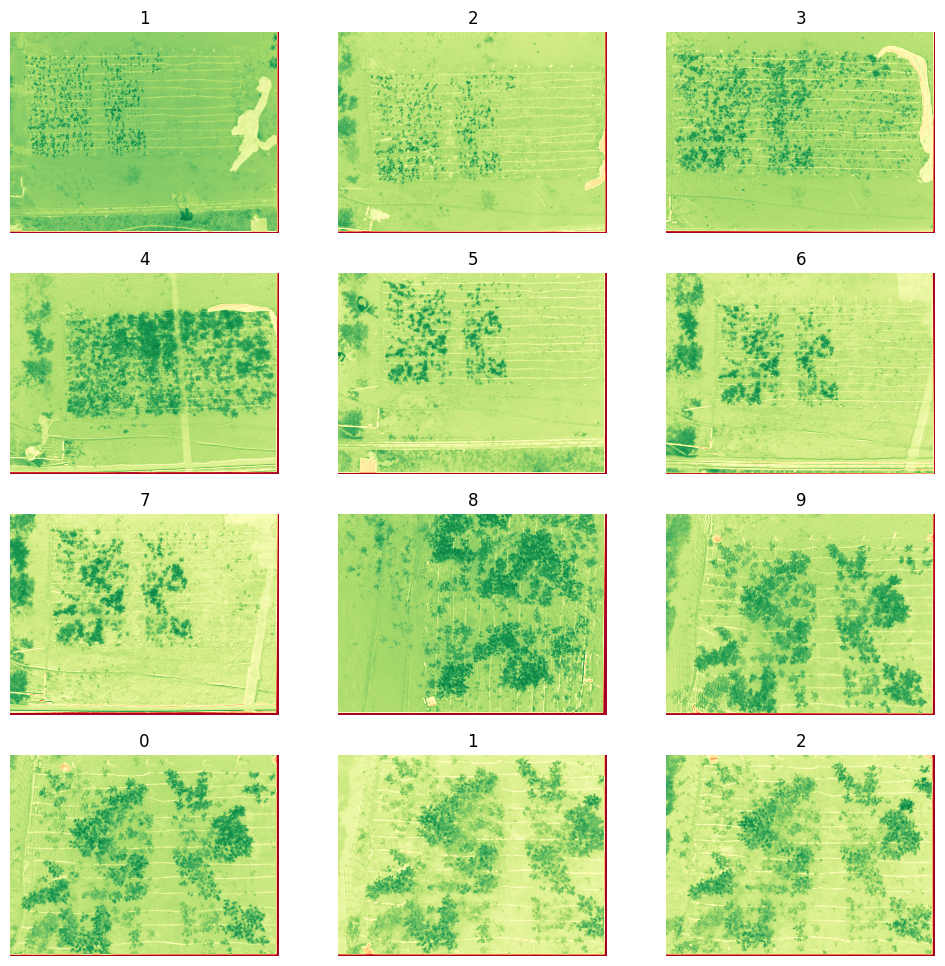

In [ ]:
titulos = [1,2,3,4,5,6,7,8,9,0,1,2]
pimp.graficar_imagenes(num_filas= 4, num_columnas= 3, titulos= titulos ,tipo="ndvi")

## Parcelación de una imagen

En caso de seleccionar una de las imágenes cargadas para parcelar se procede a utilizar el método de recorte de parcelas, donde se crea una lista de coordenadas de recorte llamada $\texttt{coordenadas_recortes}$, seguida de la llamada a la función $\texttt{recortar_imagen}$()


Para funcionar necesita:


* $\texttt{coordenadas_recortes}$: Es una lista que contiene tuplas. Cada tupla representa las coordenadas de un área rectangular a recortar en la imagen. Cada tupla tiene cuatro valores: las coordenadas (x1, y1) del vértice superior izquierdo y las coordenadas (x2, y2) del vértice inferior derecho del área rectangular.
* $\texttt{indice_imagen}$: Es un entero que indica el índice de la imagen que se va a recortar. En este caso, como ejemplo utilizaremos el indice_imagen = 11 indica que se utilizará la última imagen cargada en la instancia, teniendo en cuenta que son 12 imágenes en total y el índice de la lista de imágenes comienza en 0.
* $\texttt{tipo}$: Es una cadena que indica el tipo de imagen a recortar. En este caso, 'alineada' indica que se recortará la imagen ajustada.


La función $\texttt{recortar_imagen}$() recibe estos parámetros y devuelve una lista de parcelas recortadas de la imagen especificada. Cada parcela es una sección rectangular de la imagen original, definida por las coordenadas de recorte proporcionadas. En este caso, la variable parcelas_ndvi contendrá las parcelas cortadas de la última imagen (debido a indice_imagen = 11) en formato 'alineada' según las coordenadas especificadas en $\texttt{coordenadas_recortes}$.

In [ ]:
coordenadas_recortes = [
    (210, 0, 430, 240),
    (420, 0, 600, 260),
    (590, 0, 830, 260),
    (920, 0, 1140, 260) ,
    (1130, 0, 1320, 260) ,
    (200, 240, 410, 500),
    (400, 240, 600, 510),
    (590, 230, 840, 520),
    (920, 240, 1170, 530) ,
    (1150, 240,1400, 540) ,
    (150, 480, 390, 795),
    (400, 500, 600, 760),
    (590, 500, 840, 750),
    (940, 520, 1190, 730)  ,
    (1160, 520, 1400, 750 ) ,
    (140, 800, 340, 1050),
    (340, 770, 600, 1060),
    (580, 750, 860, 1060),
    (980, 750, 1198, 1070) ,
    (1190, 750, 1420, 1070)]
indice_imagen= 11
parcelas_ndvi=pimp.recortar_imagen(indice_imagen, coordenadas_recortes, tipo='alineada')

El código proporcionado utiliza el método $\texttt{grafica_parcelas()}$ para graficar las parcelas cortadas.

Para funcionar necesita:

* $\texttt{titulos}$: Es una lista que contiene los títulos para cada una de las parcelas cortadas, se debe tener la misma cantidad de títulos que parcelas.
* $\texttt{tipo}$: Es una cadena que indica el tipo de parcelas a graficar. En este caso, 'ndvi' indica que las parcelas cortadas provienen de la imagen con NDVI calculado.
* $\texttt{num_filas}$ y  $\texttt{num_columnas}$: Son enteros que indican el diseño de la figura donde se mostrarán las parcelas. En este caso, se ha especificado un diseño de 5 filas y 4 columnas.
* $\texttt{figsize}$: Es una tupla que indica las dimensiones de la figura a mostrar. En este caso, la figura se mostrará con un tamaño de 12x12.


La función $\texttt{grafica_parcelas()}$ tomará estos parámetros y generará una figura que contenga las parcelas cortadas dispuestas en un diseño de cuadrícula especificado, junto con los títulos correspondientes. Cada parcela se mostrará como una imagen en la figura.


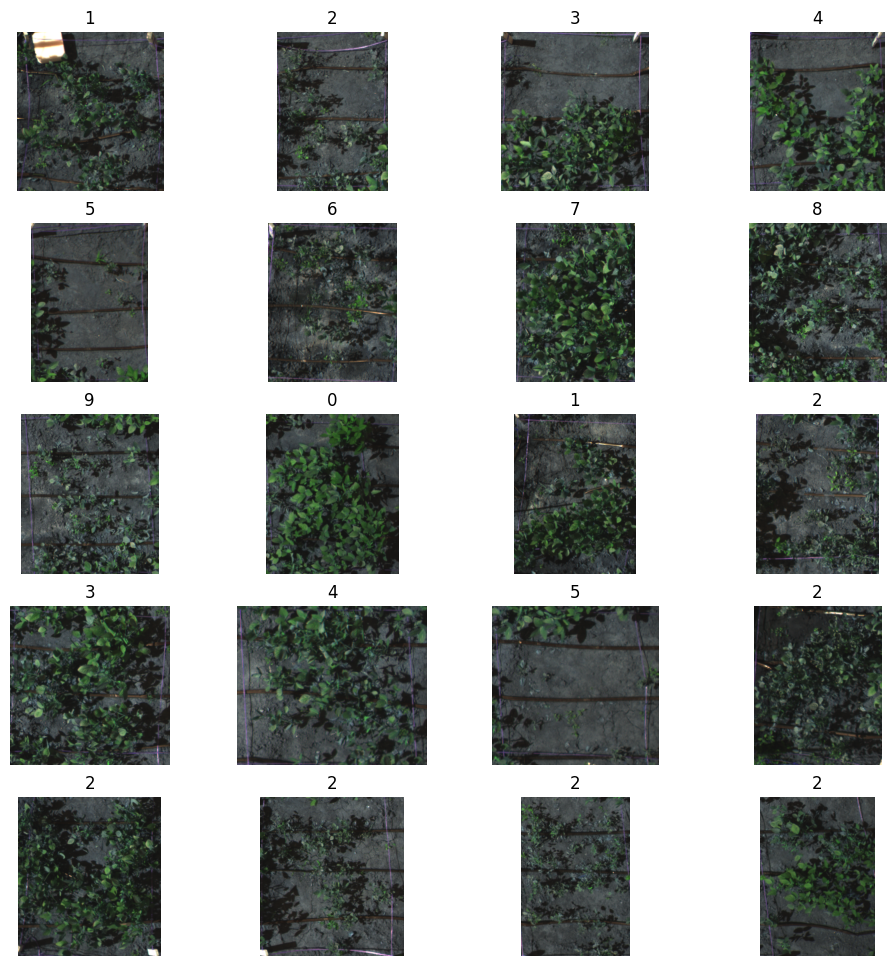

In [ ]:
titulos = [1,2,3,4,5,6,7,8,9,0,1,2,3,4,5,2,2,2,2,2]
pimp.grafica_parcelas(parcelas = parcelas_ndvi, titulos= titulos, tipo="alineada", num_filas=5, num_columnas=4, figsize=(12, 12))

# **Procedimiento para una imagen desalineada**

Se crea una instancia de la clase PIMP con una lista de rutas de archivos como parámetro de inicialización, lo primero que se debe garantizar antes de ejecutar este código es tener las imágenes disponibles en las rutas especificadas en la lista $\texttt{rutas_archivos}$. Estas rutas deben ser accesibles desde la ubicación en la que se está ejecutando el código. Para este ejemplo en la lista $\texttt{rutas_archivos}$ se contiene una sola ruta: "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_03_29/IMG_0006_".

Cuando se crea la instancia $\texttt{pimp}$ de la clase PIMP de esta manera, estás especificando una única imagen para procesar, que está ubicada en la ruta proporcionada.

In [ ]:
rutas_archivos = ["/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_03_29/IMG_0006_"]
pimp = PIMP(lista_rutas=rutas_archivos)

El método $\texttt{leer_bandas}$ se utiliza para cargar las imágenes y sus respectivas bandas, ya sea una sola imagen con sus cuatro bandas o varias imágenes con sus bandas correspondientes.

Para que funcione correctamente no se necesita ningún parámetro específico, ya que utiliza las rutas de las imágenes previamente definidas en la instancia de la clase PIMP durante la inicialización.

Cuando se llama a este método, recorre la lista de rutas de imágenes almacenadas en $\texttt{self.lista_rutas}$, carga cada imagen y lee sus cuatro bandas (azul, rojo, verde y NIR) utilizando la biblioteca OpenCV ($\texttt{cv2.imread}$) con el flag $\texttt{cv2.IMREAD_GRAYSCALE}$ para cargar las imágenes en escala de grises.

Después de cargar las bandas de cada imagen, las almacena en la lista $\texttt{self.lista_imgs}$, donde cada elemento de la lista es una lista que contiene las cuatro bandas correspondientes a una imagen.

In [ ]:
pimp.leer_bandas()

## Composición RGB

El método $\texttt{composicion_rgb}$ se utiliza para generar la composición RGB de las imágenes almacenadas en la instancia de la clase PIMP.

Para que funcione, se necesita el parámetro:

* $\texttt{tipo}$: Especifica el tipo de imágenes que se utilizarán para generar la composición RGB. En este caso, se ha especificado "cruda" para usar las imágenes originales.

El método recorre la lista con una sola imágen cargada y realiza la composición RGB. Luego, guarda cada composición en una lista correspondiente ($\texttt{lst_composicion_cruda}$). Esta lista contendrá la composición RGB generada.



In [ ]:
pimp.composicion_rgb(tipo="cruda")

El método $\texttt{graficar_imagenes}$ se utiliza para graficar las imágenes almacenadas en la instancia de la clase PIMP.

En este caso, se está solicitando graficar imágenes en su estado "crudo" (sin procesar), lo que significa que se utilizará la imágen original cargada en la instancia.

Para que funcione, se necesitan los siguientes parámetros:

* $\texttt{num_filas}$: El número de filas en el diseño de la figura que se mostrará.
* $\texttt{num_columnas}$: El número de columnas en el diseño de la figura que se mostrará.
* $\texttt{titulos}$: Una lista de títulos para cada imagen que se va a graficar. En este caso, parece que se ha proporcionado un solo título "1", que se aplicará a la única imagen que se va a graficar.
* $\texttt{tipo}$: El tipo de imágenes que se van a graficar. En este caso, se ha especificado "cruda" para usar las imágenes originales sin procesar.

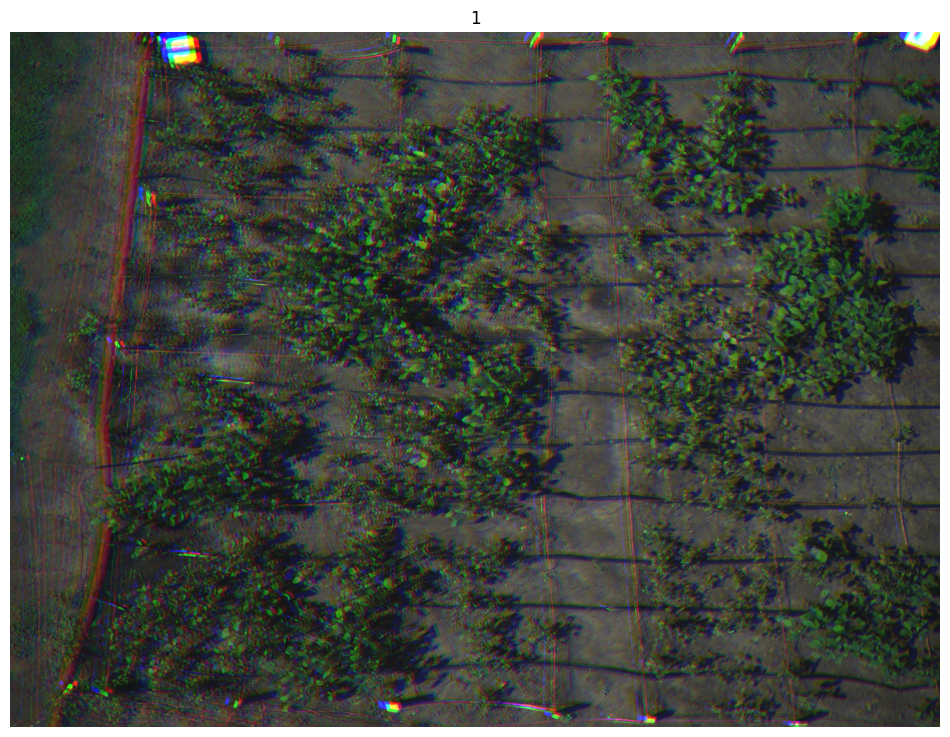

In [ ]:
pimp.graficar_imagenes(num_filas= 1, num_columnas= 1, titulos= "1",tipo="cruda")

## Cálculo de NDVI

El método $\texttt{calcular_ndvi_imagenes}$ se encarga de calcular el Índice de Vegetación de Diferencia Normalizada (NDVI) para las imágenes almacenadas en la instancia de la clase PIMP.

Para que funcione, se necesita especificar el tipo de imágenes que se van a utilizar para el cálculo del NDVI. En este caso, se ha proporcionado "cruda", lo que indica que se utilizarán las imágenes originales sin ningún tipo de procesamiento adicional.

El resultado es una lista que contiene los NDVI calculados en este caso es uno por ser una imagen, que se almacena en el atributo  $\texttt{resultados_ndvi}$.

In [ ]:
pimp.calcular_ndvi_imagenes(tipo="cruda")

[array([[ 0.3880597 ,  0.44217687,  0.46206897, ...,  0.70114943,
          0.65644172,  0.52173913],
        [ 0.44736842,  0.34131737,  0.29411765, ...,  0.6969697 ,
          0.61627907,  0.48888889],
        [ 0.50318471,  0.46478873,  0.16959064, ...,  0.67630058,
          0.54098361,  0.44973545],
        ...,
        [ 0.02912621,  0.04081633,  0.09677419, ...,  0.31506849,
          0.36986301,  0.41025641],
        [-0.02040816,  0.11320755,  0.18181818, ...,  0.39759036,
          0.39759036,  0.41860465],
        [ 0.04950495,  0.13461538,  0.14545455, ...,  0.19642857,
          0.17647059,  0.15      ]])]

El método $\texttt{graficar_imagenes}$ se encarga de visualizar las imágenes almacenadas en la lista $\texttt{lista_imagenes}$, ya sea que estas sean imágenes RGB o imágenes del NDVI.

Para que funcione, se necesitan los siguientes elementos:
* $\texttt{num_filas}$ y $\texttt{num_columnas}$: Estos parámetros determinan la disposición de las imágenes en la figura que se mostrará. En este caso, se especifica que habrá una sola fila y una sola columna, lo que significa que se mostrará una única imagen.
* $\texttt{titulos}$: El parámetro titulos espera una lista de títulos para cada subfigura. Aunque se proporciona un solo título en forma de cadena de caracteres, es necesario envolverlo en una lista para que coincida con el formato esperado.
* $\texttt{tipo}$: El parámetro tipo indica qué tipo de imágenes se van a graficar. En este caso, se especifica 'ndvi', lo que significa que se espera graficar imágenes del Índice de Vegetación de Diferencia Normalizada.

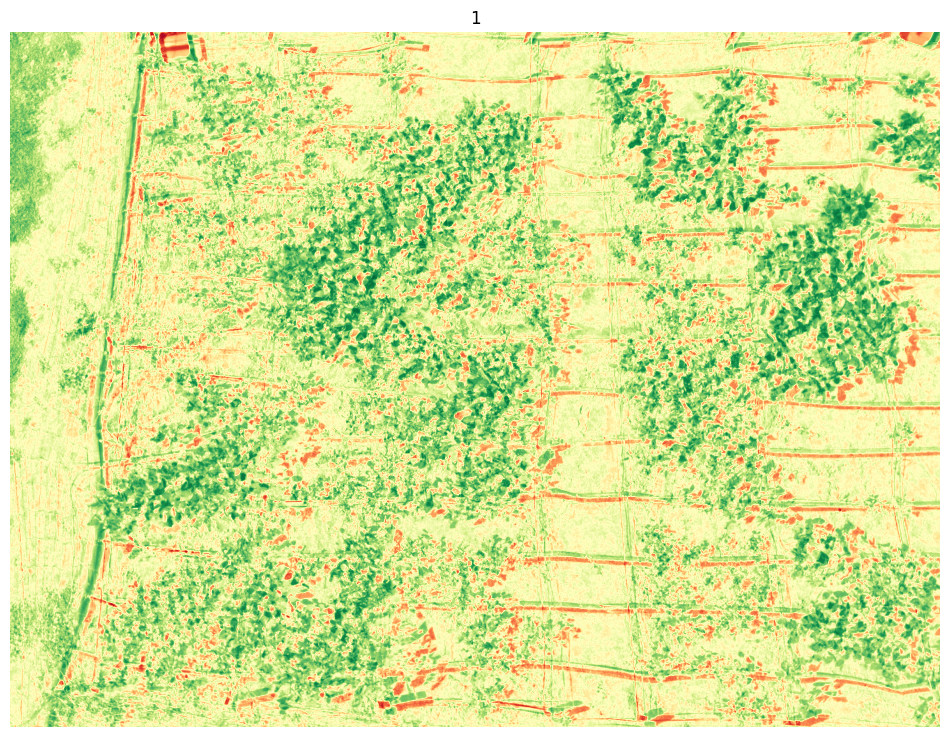

In [ ]:
pimp.graficar_imagenes(num_filas= 1, num_columnas= 1, titulos= "1",tipo="ndvi")

El método $\texttt{graficar_histobox_ndvi}$ genera y muestra histogramas o boxplots de los valores del NDVI calculados para las imágenes cargadas, para que funcione, este método necesita los siguientes elementos:
* $\texttt{titulos}$: Debes proporcionar una lista de títulos para cada gráfico que se generará. En este caso, se proporciona un título para un solo gráfico.
* $\texttt{num_filas}$ y $\texttt{num_columnas}$: Debes especificar el diseño de la figura que mostrará los gráficos. Esto se hace proporcionando el número de filas y columnas en la figura.
* $\texttt{tipo_grafico}$: Puedes elegir entre generar histogramas o boxplots de los valores del NDVI igualando este parámetro a  'histograma' o 'boxplot'.

**Este es un ejemplo de Boxplot.**



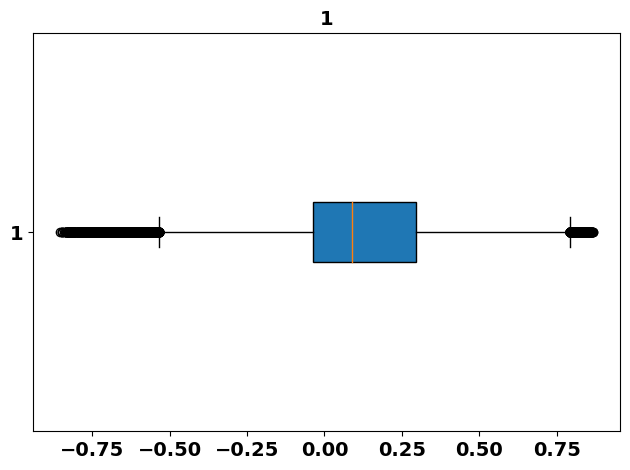

In [ ]:
pimp.graficar_histobox_ndvi(titulos=  ['1'], num_filas=1, num_columnas=1, tipo_grafico='boxplot')

**Este es un ejemplo de Histograma.**

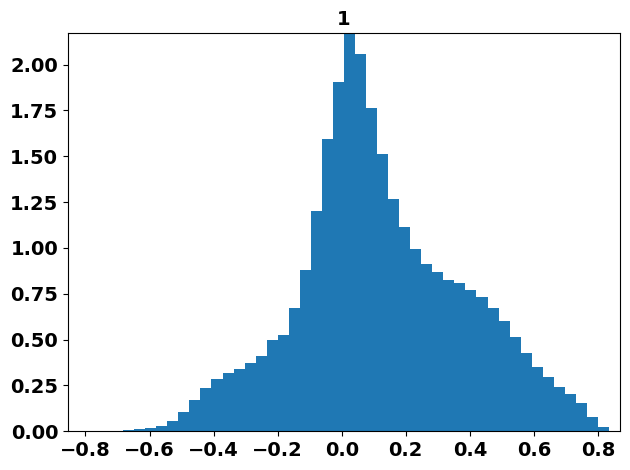

In [ ]:
pimp.graficar_histobox_ndvi(titulos = ['1'], num_filas=1, num_columnas=1, tipo_grafico='histograma')

## Parcelación

En esta instancia para el recorte de parcelas se crea una lista de coordenadas de recorte llamada $\texttt{coordenadas_recortes}$, seguida de la llamada a la función $\texttt{recortar_imagen}$()

Para funcionar necesita:

* $\texttt{coordenadas_recortes}$: Es una lista que contiene tuplas. Cada tupla representa las coordenadas de un área rectangular a recortar en la imagen. Cada tupla tiene cuatro valores: las coordenadas (x1, y1) del vértice superior izquierdo y las coordenadas (x2, y2) del vértice inferior derecho del área rectangular.
* $\texttt{indice_imagen}$: Es un entero que indica el índice de la imagen que se va a recortar. En este caso, indice_imagen = 0 indica que se utilizará la primera imagen cargada en la instancia de pimp ya que es solo una imagen.
En caso de continuar luego de ejecutado el procedimiento para varias imágenes se debe seleccionar el índice de imagen considerando el orden de carga de las rutas a la inicialización de la clase, si se quiere utilizar por ejemplo la imagen que pertenece a la 2ª ruta se debe especificar el índice 1, dado que la lista comienza en indice 0.
* $\texttt{tipo}$: Es una cadena que indica el tipo de imagen a recortar. En este caso, 'cruda' indica que se recortará la imagen original sin ninguna transformación aplicada.

La función $\texttt{recortar_imagen}$() recibe estos parámetros y devuelve una lista de parcelas recortadas de la imagen especificada. Cada parcela es una sección rectangular de la imagen original, definida por las coordenadas de recorte proporcionadas. En este caso, la variable parcelas_ndvi contendrá las parcelas cortadas de la primera imagen (debido a indice_imagen = 0) en formato 'cruda' según las coordenadas especificadas en $\texttt{coordenadas_recortes}$.


In [ ]:
coordenadas_recortes = [
    (210, 0, 430, 240),
    (420, 0, 600, 260),
    (590, 0, 830, 260),
    (920, 0, 1140, 260) ,
    (1130, 0, 1320, 260) ,
    (200, 240, 410, 500),
    (400, 240, 600, 510),
    (590, 230, 840, 520),
    (920, 240, 1170, 530) ,
    (1150, 240,1400, 540) ,
    (150, 480, 390, 795),
    (400, 500, 600, 760),
    (590, 500, 840, 750),
    (940, 520, 1190, 730)  ,
    (1160, 520, 1400, 750 ) ,
    (140, 800, 340, 1050),
    (340, 770, 600, 1060),
    (580, 750, 860, 1060),
    (980, 750, 1198, 1070) ,
    (1190, 750, 1420, 1070)]
indice_imagen= 0
parcelas_ndvi= pimp.recortar_imagen(indice_imagen, coordenadas_recortes, tipo='cruda')

El código proporcionado utiliza el método $\texttt{grafica_parcelas()}$ para graficar las parcelas cortadas.


Para funcionar necesita:


* $\texttt{titulos}$: Es una lista que contiene los títulos para cada una de las parcelas cortadas, se debe tener la misma cantidad de títulos que parcelas.
* $\texttt{tipo}$: Es una cadena que indica el tipo de parcelas a graficar. En este caso, 'cruda' indica que las parcelas cortadas provienen de la imagen sin alinear.
* $\texttt{num_filas}$ y  $\texttt{num_columnas}$: Son enteros que indican el diseño de la figura donde se mostrarán las parcelas. En este caso, se ha especificado un diseño de 5 filas y 4 columnas.
* $\texttt{figsize}$: Es una tupla que indica las dimensiones de la figura a mostrar. En este caso, la figura se mostrará con un tamaño de 12x12.


La función $\texttt{grafica_parcelas()}$ tomará estos parámetros y generará una figura que contenga las parcelas cortadas dispuestas en un diseño de cuadrícula especificado, junto con los títulos correspondientes. Cada parcela se mostrará como una imagen en la figura.




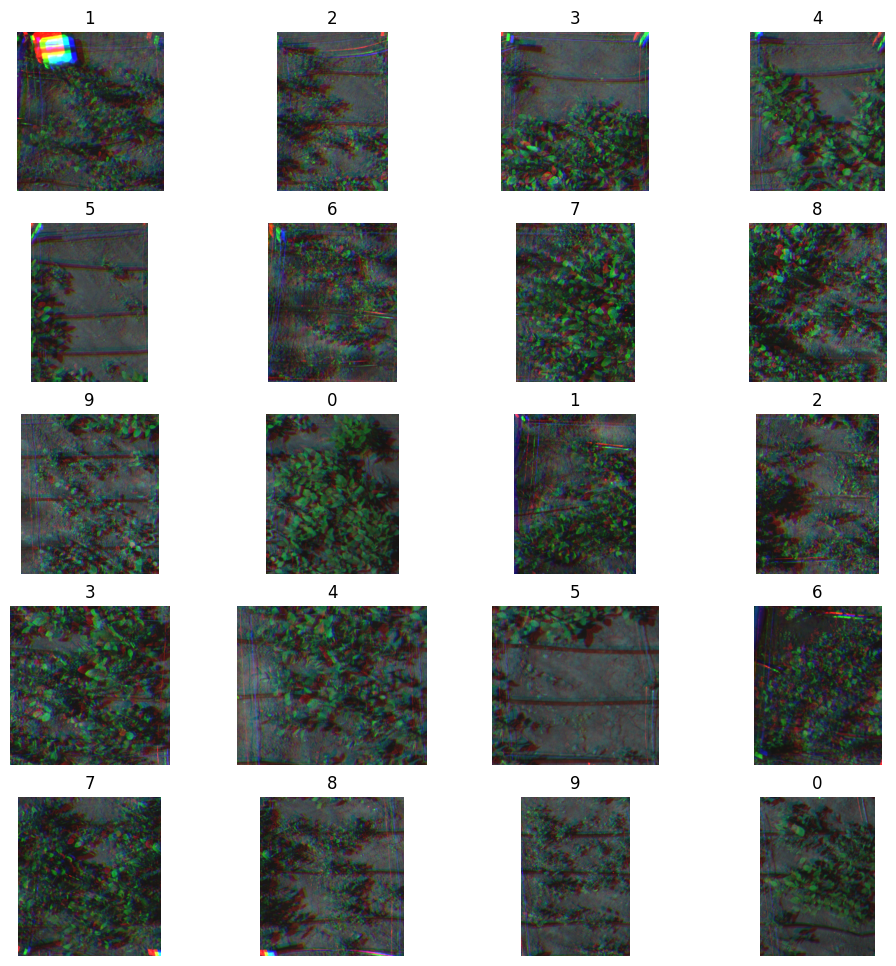

In [ ]:
titulos = [1,2,3,4,5,6,7,8,9,0,1,2,3,4,5,6,7,8,9,0]
pimp.grafica_parcelas( parcelas= parcelas_ndvi, titulos= titulos, tipo="cruda", num_filas=5, num_columnas=4, figsize=(12, 12))

## NDVI parcelación

En esta instancia para el recorte de parcelas pero esta vez NDVI, al igual que con la parcelacion anterior se crea una lista de coordenadas de recorte llamada $\texttt{coordenadas_recortes}$, seguida de la llamada a la función $\texttt{recortar_imagen}$()


Para funcionar necesita:


* $\texttt{coordenadas_recortes}$: Es una lista que contiene tuplas. Cada tupla representa las coordenadas de un área rectangular a recortar en la imagen. Cada tupla tiene cuatro valores: las coordenadas (x1, y1) del vértice superior izquierdo y las coordenadas (x2, y2) del vértice inferior derecho del área rectangular.
* $\texttt{indice_imagen}$: Es un entero que indica el índice de la imagen que se va a recortar. En este caso, indice_imagen = 0 indica que se utilizará la primera imagen cargada en la instancia de pimp ya que es solo una imagen.
En caso de continuar luego de ejecutado el procedimiento para varias imágenes se debe seleccionar el índice de imagen considerando el orden de carga de las rutas a la inicialización de la clase, si se quiere utilizar por ejemplo la imagen que pertenece a la 2ª ruta se debe especificar el índice 1, dado que la lista comienza en indice 0.
* $\texttt{tipo}$: Es una cadena que indica el tipo de imagen a recortar, en este caso, 'ndvi'.


La función $\texttt{recortar_imagen}$() recibe estos parámetros y devuelve una lista de parcelas recortadas de la imagen especificada. Cada parcela es una sección rectangular de la imagen original, definida por las coordenadas de recorte proporcionadas. En este caso, la variable parcelas_ndvi contendrá las parcelas cortadas de la primera imagen (debido a indice_imagen = 0) en formato 'cruda' según las coordenadas especificadas en $\texttt{coordenadas_recortes}$.


In [ ]:
coordenadas_recortes = [
    (210, 0, 430, 240),
    (420, 0, 600, 260),
    (590, 0, 830, 260),
    (920, 0, 1140, 260) ,
    (1130, 0, 1320, 260) ,
    (200, 240, 410, 500),
    (400, 240, 600, 510),
    (590, 230, 840, 520),
    (920, 240, 1170, 530) ,
    (1150, 240,1400, 540) ,
    (150, 480, 390, 795),
    (400, 500, 600, 760),
    (590, 500, 840, 750),
    (940, 520, 1190, 730)  ,
    (1160, 520, 1400, 750 ) ,
    (140, 800, 340, 1050),
    (340, 770, 600, 1060),
    (580, 750, 860, 1060),
    (980, 750, 1198, 1070) ,
    (1190, 750, 1420, 1070)]
indice_imagen= 0
parcelas_ndvi = pimp.recortar_imagen(indice_imagen, coordenadas_recortes, tipo='ndvi')

El código proporcionado utiliza el método $\texttt{grafica_parcelas()}$ para graficar las parcelas cortadas.


Para funcionar necesita:


* $\texttt{titulos}$: Es una lista que contiene los títulos para cada una de las parcelas cortadas, se debe tener la misma cantidad de títulos que parcelas.
* $\texttt{tipo}$: Es una cadena que indica el tipo de parcelas a graficar. En este caso, 'ndvi' indica que las parcelas cortadas provienen de la imagen con NDVI calculado.
* $\texttt{num_filas}$ y  $\texttt{num_columnas}$: Son enteros que indican el diseño de la figura donde se mostrarán las parcelas. En este caso, se ha especificado un diseño de 5 filas y 4 columnas.
* $\texttt{figsize}$: Es una tupla que indica las dimensiones de la figura a mostrar. En este caso, la figura se mostrará con un tamaño de 12x12.


La función $\texttt{grafica_parcelas()}$ tomará estos parámetros y generará una figura que contenga las parcelas cortadas dispuestas en un diseño de cuadrícula especificado, junto con los títulos correspondientes. Cada parcela se mostrará como una imagen en la figura.



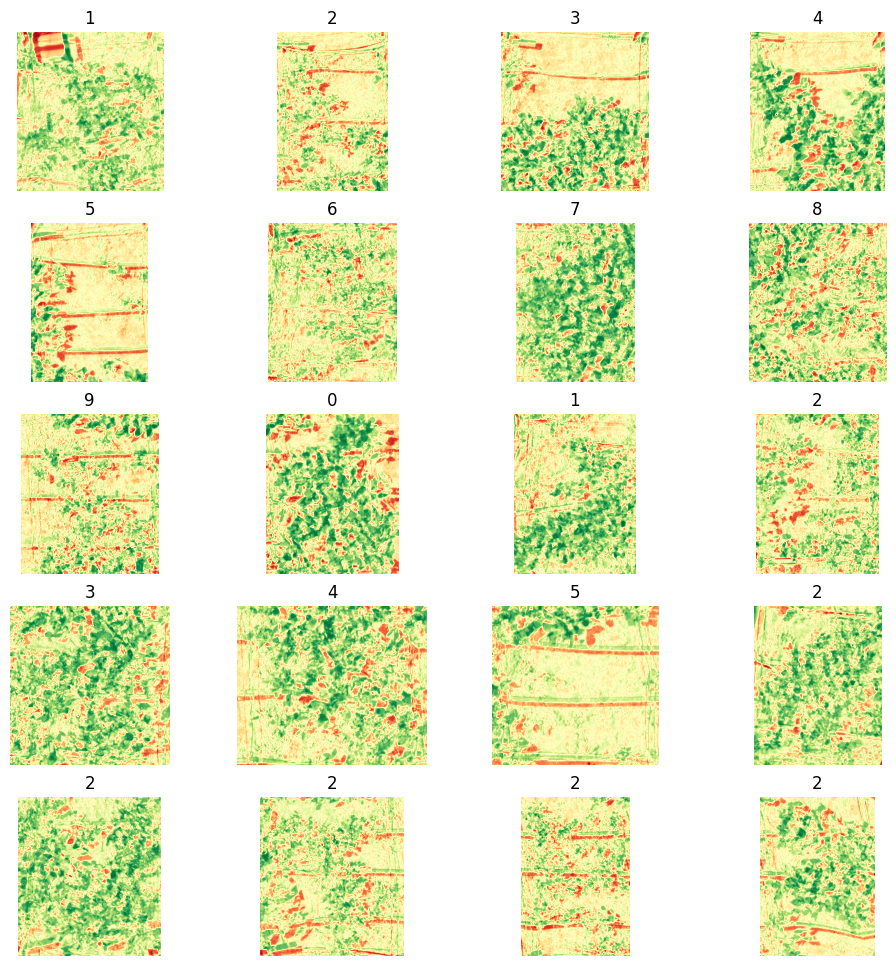

In [ ]:
titulos = [1,2,3,4,5,6,7,8,9,0,1,2,3,4,5,2,2,2,2,2]
pimp.grafica_parcelas(parcelas = parcelas_ndvi, titulos= titulos, tipo="ndvi", num_filas=5, num_columnas=4, figsize=(12, 12))

## Correlación

Se definen dos listas, $\texttt{x}$ e $\texttt{y}$ que contienen valores numéricos de variables in-situ en este caso.
Se imprime la longitud de las listas x e y con  la función $\texttt{print()}$ para verificar que ambas listas tienen la misma longitud.
Al llamar al método $\texttt{filtrar_pixeles()}$ de la instancia pimp de la clase PIMP, pasando como argumentos la lista de parcelas NDVI, las listas x e y, y el umbral de filtrado (0.2). Esto filtra los píxeles de cada parcela NDVI según el umbral especificado y calcula estadísticas adicionales (**Media Aritmética** de los valores de pixeles mayores a 0.3 y **Desviación Media Absoluta** de estos mismos valores) para cada imagen NDVI.
El resultado será un DataFrame llamado $\texttt{resultados}$ que contendrá la cantidad de píxeles filtrados y las estadísticas adicionales calculadas para cada imagen NDVI, junto con las variables x e y si se proporcionan.


**Recordar que todas las variables deben tener igual longitud para la ejecución correcta**



In [ ]:
x= [14.43 , 11.93 , 19.83, 16.00, 6.14, 7.67, 24.72, 18.47, 12.32, 20.59, 20.27, 9.33, 16.25, 11.29, 2.83, 29.08, 26.84, 11.40, 17.57, 14.24]
y= [1.65, 1.07, 2.27, 2.46, 0.53, 0.64, 3.46, 1.89, 1.35, 3.35, 3.15, 1.07, 2.45, 1.44, 0.17, 2.88, 3.61, 1.08, 1.39, 2.20]

print(len(x))
print(len(y))
resultados = pimp.filtrar_pixeles(parcelas_ndvi, x=x,y=y, umbral=0.2)

20
20


El método $\texttt{graficar_correlacion()}$ genera y grafica la matriz de correlación entre las variables del DataFrame $\texttt{resultados}$ utilizando la biblioteca Seaborn. La matriz de correlación muestra la relación entre todas las variables del DataFrame, incluidas las variables x e y si están presentes. Las celdas de la matriz de correlación están coloreadas según el valor de correlación, lo que facilita la identificación de patrones y relaciones entre las variables.


**Recordar que todas las variables deben tener igual longitud para la ejecución correcta**



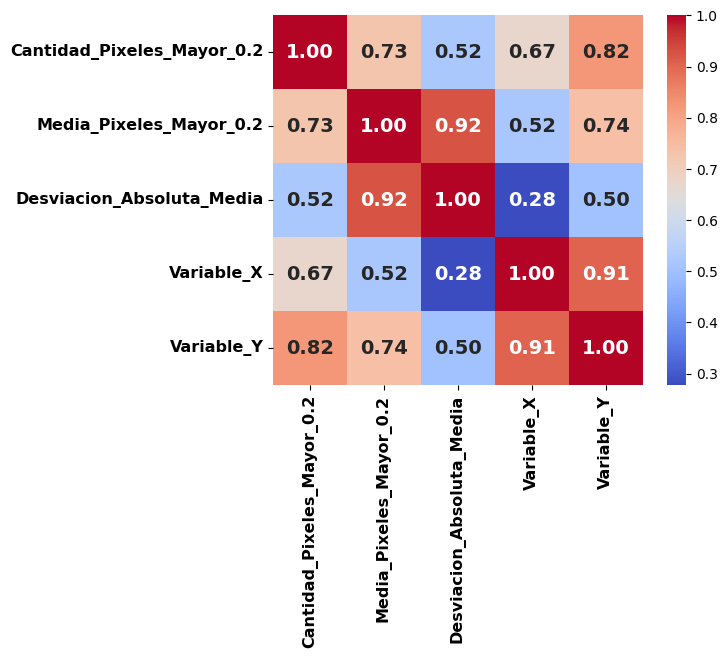

In [ ]:
pimp.graficar_correlacion(resultados)

# **Procedimiento para una imagen alineada**

Se crea una instancia de la clase PIMP con una lista de rutas de archivos como parámetro de inicialización, lo primero que se debe garantizar antes de ejecutar este código es tener las imágenes disponibles en las rutas especificadas en la lista $\texttt{rutas_archivos}$. Estas rutas deben ser accesibles desde la ubicación en la que se está ejecutando el código. Para este ejemplo en la lista $\texttt{rutas_archivos}$ se contiene una sola ruta: "/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_03_29/IMG_0006_".

Cuando se crea la instancia $\texttt{pimp}$ de la clase PIMP de esta manera, estás especificando una única imagen para procesar, que está ubicada en la ruta proporcionada.

In [ ]:
rutas_archivos = ["/content/drive/MyDrive/PASANTIA_AV_FOTOS/2023_03_29/IMG_0006_"]
pimp = PIMP(lista_rutas=rutas_archivos)

El método $\texttt{leer_bandas}$ se utiliza para cargar las imágenes y sus respectivas bandas, ya sea una sola imagen con sus cuatro bandas o varias imágenes con sus bandas correspondientes.

Para que funcione correctamente no se necesita ningún parámetro específico, ya que utiliza las rutas de las imágenes previamente definidas en la instancia de la clase PIMP durante la inicialización.

Cuando se llama a este método, recorre la lista de rutas de imágenes almacenadas en $\texttt{self.lista_rutas}$, carga cada imagen y lee sus cuatro bandas (azul, rojo, verde y NIR) utilizando la biblioteca OpenCV ($\texttt{cv2.imread}$) con el flag $\texttt{cv2.IMREAD_GRAYSCALE}$ para cargar las imágenes en escala de grises.

Después de cargar las bandas de cada imagen, las almacena en la lista $\texttt{self.lista_imgs}$, donde cada elemento de la lista es una lista que contiene las cuatro bandas correspondientes a una imagen.

In [ ]:
pimp.leer_bandas()

## Alineación de canales

El método $\texttt{self.alineacion_canales}$ se utiliza para alinear las bandas de imágenes multiespectrales. Este método realiza un proceso de alineación de las bandas utilizando la banda roja como referencia y ajustando las demás bandas (verde, azul y NIR) para que coincidan con esta. Utiliza un algoritmo de alineación basado en la maximización del coeficiente de correlación mejorado (ECC) para encontrar las mejores transformaciones que alineen las bandas verde, azul y NIR con la banda roja.


Necesita el parámetro $\texttt{numero_iteraciones}$ que indica la cantidad de iteraciones que el algoritmo debe realizar para optimizar la alineación. En este caso, `numero_iteraciones` está establecido en 50, puede ajustarse aumentando o disminuyendo este valor para obtener resultados más precisos o acelerar el proceso según las necesidades específicas del análisis.


Al terminar la imagen alineada se almacenará en una lista `lista_imgs_alineadas`.



In [ ]:
pimp.alineacion_canales(numero_iteraciones = 50)

El método composicion_rgb() genera la composición RGB de las imágenes alineadas. Aquí, al especificar tipo="alineada", se asegura de que se utilicen las imágenes previamente alineadas. La función procede a realizar la composición combinando las bandas Roja, Verde y Azul de cada imagen alineada. El resultado es una lista que contiene las composiciones RGB de las imágenes, lo que facilita su visualización y análisis posterior.

## Composición RGB

El método $\texttt{composicion_rgb}$ se utiliza para generar la composición RGB de las imágenes almacenadas en la instancia de la clase PIMP.

Para que funcione, se necesita el parámetro:

* $\texttt{tipo}$: Especifica el tipo de imágenes que se utilizarán para generar la composición RGB. En este caso, se ha especificado "alineada" para usar las imágenes ajustadas.

El método recorre la lista con una sola imágen cargada y realiza la composición RGB. Luego, guarda cada composición en una lista correspondiente ($\texttt{lst_composicion_alineada}$). Esta lista contendrá la composicion RGB generada.

In [ ]:
pimp.composicion_rgb(tipo="alineada")

El método $\texttt{graficar_imagenes}$ se utiliza para graficar las imágenes almacenadas en la instancia de la clase PIMP.

En este caso, se está solicitando graficar imágenes en su estado "alineado" (ajustadas), lo que significa que se utilizará la imágen alineada en la instancia.

Para que funcione, se necesitan los siguientes parámetros:

* $\texttt{num_filas}$: El número de filas en el diseño de la figura que se mostrará.
* $\texttt{num_columnas}$: El número de columnas en el diseño de la figura que se mostrará.
* $\texttt{titulos}$: Una lista de títulos para cada imagen que se va a graficar. En este caso, parece que se ha proporcionado un solo título "1", que se aplicará a la única imagen que se va a graficar.
* $\texttt{tipo}$: El tipo de imágenes que se van a graficar. En este caso, se ha especificado "alineada" para usar las imágenes alineadas anteriormente.

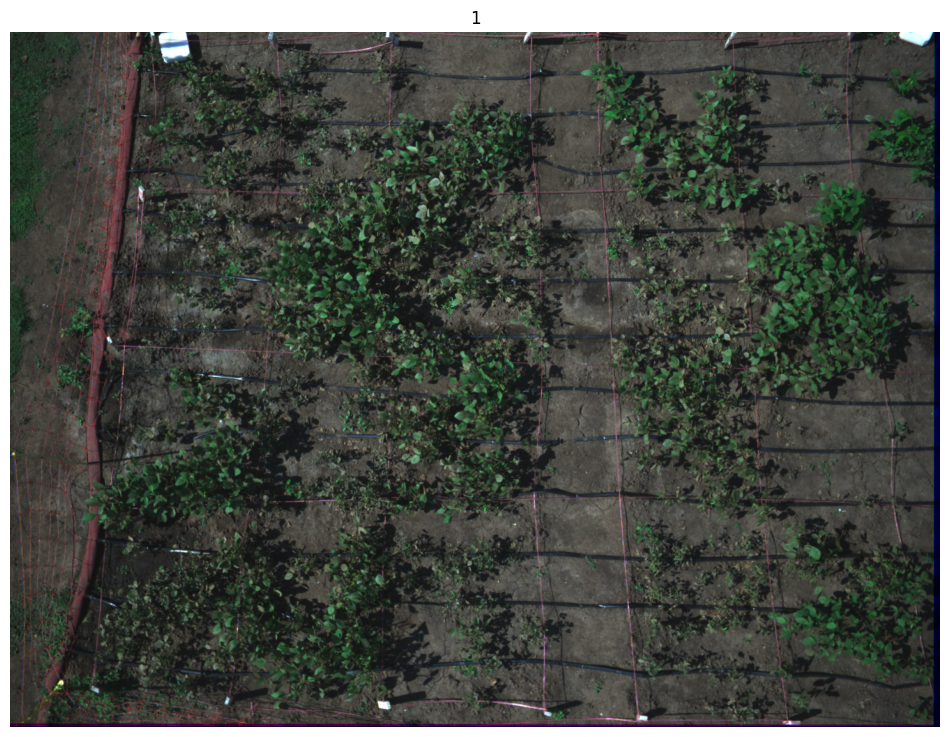

In [ ]:
pimp.graficar_imagenes(num_filas= 1, num_columnas= 1, titulos= "1",tipo="alineada")

## Calcular NDVI

El método $\texttt{calcular_ndvi_imagenes}$ se encarga de calcular el Índice de Vegetación de Diferencia Normalizada (NDVI) para las imágenes almacenadas en la instancia de la clase PIMP.

Para que funcione, se necesita especificar el tipo de imágenes que se van a utilizar para el cálculo del NDVI. En este caso, se ha proporcionado "alineada", lo que indica que se utilizarán las imágenes con el procesamiento de alineación aplicado.

El resultado es una lista que contiene los NDVI calculados en este caso es uno por ser una imagen, que se almacena en el atributo  $\texttt{resultados_ndvi}$.

In [ ]:
resultados_ndvi_ = pimp.calcular_ndvi_imagenes(tipo="alineada")

El método $\texttt{graficar_imagenes}$ se encarga de visualizar las imágenes almacenadas en la lista $\texttt{lista_imagenes}$, ya sea que estas sean imágenes RGB o imágenes del NDVI.

Para que funcione, se necesitan los siguientes elementos:
* $\texttt{num_filas}$ y $\texttt{num_columnas}$: Estos parámetros determinan la disposición de las imágenes en la figura que se mostrará. En este caso, se especifica que habrá una sola fila y una sola columna, lo que significa que se mostrará una única imagen.
* $\texttt{titulos}$: El parámetro titulos espera una lista de títulos para cada subfigura. Aunque se proporciona un solo título en forma de cadena de caracteres, es necesario envolverlo en una lista para que coincida con el formato esperado.
* $\texttt{tipo}$: El parámetro tipo indica qué tipo de imágenes se van a graficar. En este caso, se especifica 'ndvi', lo que significa que se espera graficar imágenes del Índice de Vegetación de Diferencia Normalizada.

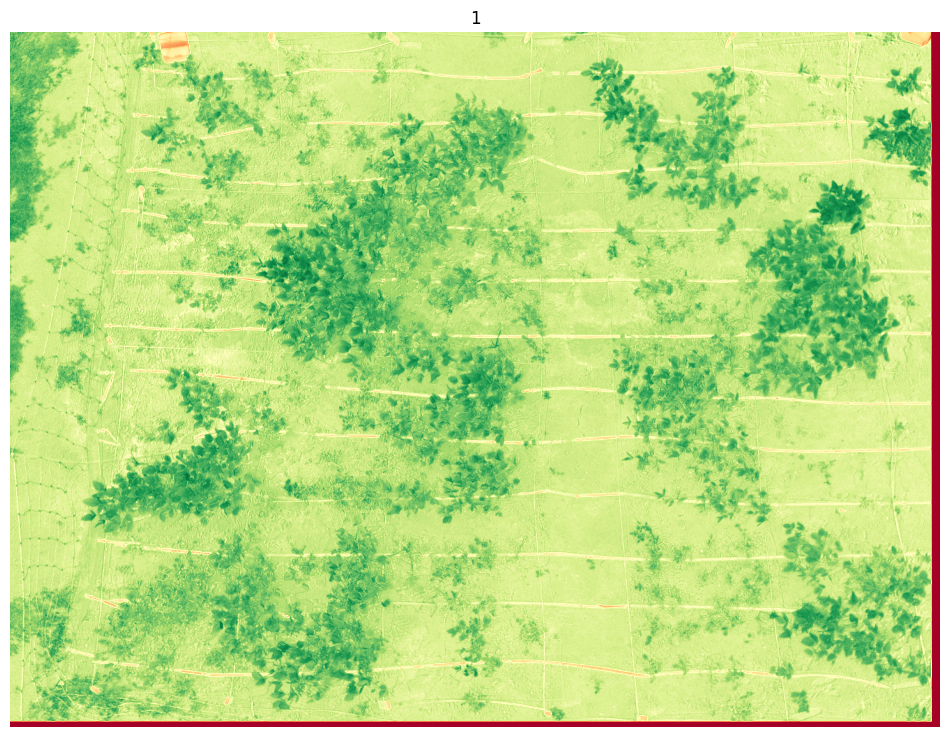

In [ ]:
pimp.graficar_imagenes(num_filas= 1, num_columnas= 1, titulos= "1",tipo="ndvi")

El método $\texttt{graficar_histobox_ndvi}$ genera y muestra histogramas o boxplots de los valores del NDVI calculados para las imágenes cargadas, para que funcione, este método necesita los siguientes elementos:
* $\texttt{titulos}$: Debes proporcionar una lista de títulos para cada gráfico que se generará. En este caso, se proporciona un título para un solo gráfico.
* $\texttt{num_filas}$ y $\texttt{num_columnas}$: Debes especificar el diseño de la figura que mostrará los gráficos. Esto se hace proporcionando el número de filas y columnas en la figura.
* $\texttt{tipo_grafico}$: Puedes elegir entre generar histogramas o boxplots de los valores del NDVI igualando este parametro a  'histograma' o 'boxplot'.

**Este es un ejemplo de Histograma.**

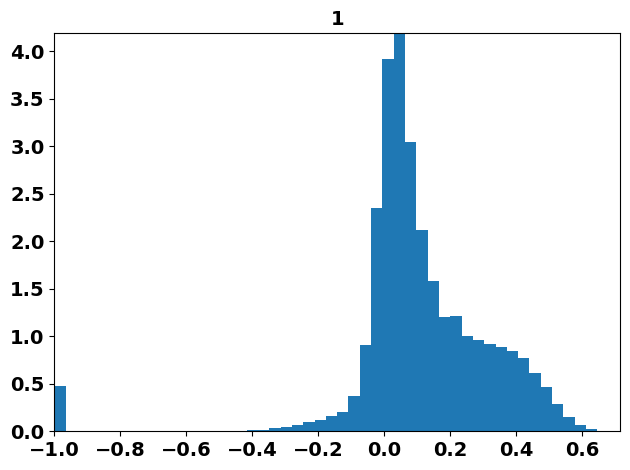

In [ ]:
pimp.graficar_histobox_ndvi(titulos = ['1'], num_filas=1, num_columnas=1, tipo_grafico='histograma')

**Esto es un ejemplo de Boxplot**

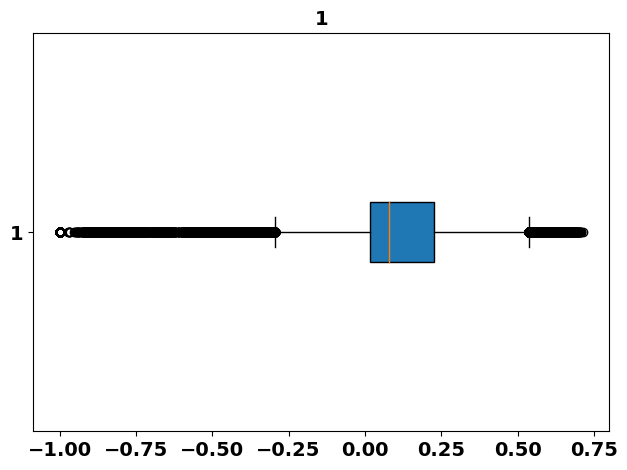

In [ ]:
pimp.graficar_histobox_ndvi(titulos=  ['1'], num_filas=1, num_columnas=1, tipo_grafico='boxplot')

## Parcelación

En esta instancia para el recorte de parcelas se crea una lista de coordenadas de recorte llamada $\texttt{coordenadas_recortes}$, seguida de la llamada a la función $\texttt{recortar_imagen}$()


Para funcionar necesita:


* $\texttt{coordenadas_recortes}$: Es una lista que contiene tuplas. Cada tupla representa las coordenadas de un área rectangular a recortar en la imagen. Cada tupla tiene cuatro valores: las coordenadas (x1, y1) del vértice superior izquierdo y las coordenadas (x2, y2) del vértice inferior derecho del área rectangular.
* $\texttt{indice_imagen}$: Es un entero que indica el índice de la imagen que se va a recortar. En este caso, indice_imagen = 0 indica que se utilizará la primera imagen cargada en la instancia de pimp ya que es solo una imagen.
En caso de continuar luego de ejecutado el procedimiento para varias imágenes se debe seleccionar el índice de imagen considerando el orden de carga de las rutas a la inicialización de la clase, si se quiere utilizar por ejemplo la imagen que pertenece a la 2ª ruta se debe especificar el índice 1, dado que la lista comienza en indice 0.
* $\texttt{tipo}$: Es una cadena que indica el tipo de imagen a recortar. En este caso, 'alineada' indica que se recortará la imagen ajustada.


La función $\texttt{recortar_imagen}$() recibe estos parámetros y devuelve una lista de parcelas recortadas de la imagen especificada. Cada parcela es una sección rectangular de la imagen original, definida por las coordenadas de recorte proporcionadas. En este caso, la variable parcelas_ndvi contendrá las parcelas cortadas de la primera imagen (debido a indice_imagen = 0) en formato 'cruda' según las coordenadas especificadas en $\texttt{coordenadas_recortes}$.


In [ ]:
coordenadas_recortes = [
    (210, 0, 430, 240),
    (420, 0, 600, 260),
    (590, 0, 830, 260),
    (920, 0, 1140, 260) ,
    (1130, 0, 1320, 260) ,
    (200, 240, 410, 500),
    (400, 240, 600, 510),
    (590, 230, 840, 520),
    (920, 240, 1170, 530) ,
    (1150, 240,1400, 540) ,
    (150, 480, 390, 795),
    (400, 500, 600, 760),
    (590, 500, 840, 750),
    (940, 520, 1190, 730)  ,
    (1160, 520, 1400, 750 ) ,
    (140, 800, 340, 1050),
    (340, 770, 600, 1060),
    (580, 750, 860, 1060),
    (980, 750, 1198, 1070) ,
    (1190, 750, 1420, 1070)]
indice_imagen= 0
parcelas_ndvi = pimp.recortar_imagen(indice_imagen, coordenadas_recortes, tipo='alineada')

El código proporcionado utiliza el método $\texttt{grafica_parcelas()}$ para graficar las parcelas cortadas.


Para funcionar necesita:


* $\texttt{titulos}$: Es una lista que contiene los títulos para cada una de las parcelas cortadas, se debe tener la misma cantidad de títulos que parcelas.
* $\texttt{tipo}$: Es una cadena que indica el tipo de parcelas a graficar. En este caso, 'cruda' indica que las parcelas cortadas provienen de la imagen sin alinear.
* $\texttt{num_filas}$ y  $\texttt{num_columnas}$: Son enteros que indican el diseño de la figura donde se mostrarán las parcelas. En este caso, se ha especificado un diseño de 5 filas y 4 columnas.
* $\texttt{figsize}$: Es una tupla que indica las dimensiones de la figura a mostrar. En este caso, la figura se mostrará con un tamaño de 12x12.


La función $\texttt{grafica_parcelas()}$ tomará estos parámetros y generará una figura que contenga las parcelas cortadas dispuestas en un diseño de cuadrícula especificado, junto con los títulos correspondientes. Cada parcela se mostrará como una imagen en la figura.


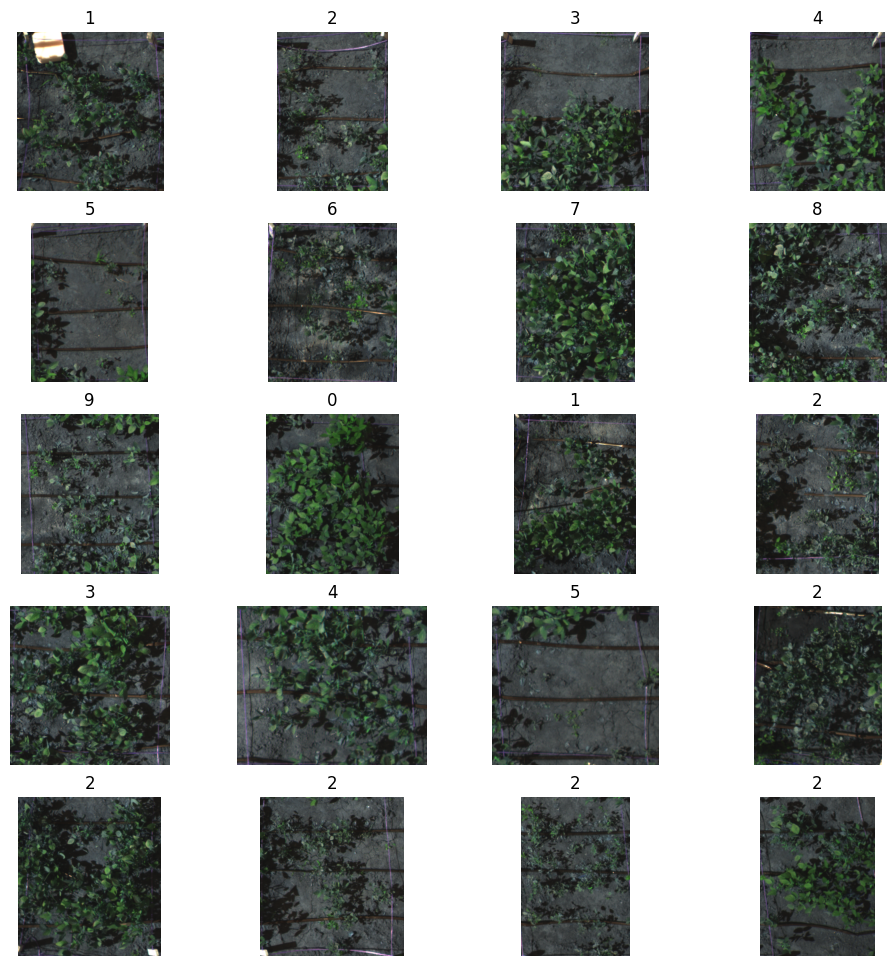

In [ ]:
titulos = [1,2,3,4,5,6,7,8,9,0,1,2,3,4,5,2,2,2,2,2]
pimp.grafica_parcelas(parcelas = parcelas_ndvi, titulos= titulos, tipo="alineada", num_filas=5, num_columnas=4, figsize=(12, 12))

## NDVI parcelación

En esta instancia para el recorte de parcelas pero esta vez NDVI, al igual que con la parcelación anterior se crea una lista de coordenadas de recorte llamada $\texttt{coordenadas_recortes}$, seguida de la llamada a la función $\texttt{recortar_imagen}$()


Para funcionar necesita:


* $\texttt{coordenadas_recortes}$: Es una lista que contiene tuplas. Cada tupla representa las coordenadas de un área rectangular a recortar en la imagen. Cada tupla tiene cuatro valores: las coordenadas (x1, y1) del vértice superior izquierdo y las coordenadas (x2, y2) del vértice inferior derecho del área rectangular.
* $\texttt{indice_imagen}$: Es un entero que indica el índice de la imagen que se va a recortar. En este caso, indice_imagen = 0 indica que se utilizará la primera imagen cargada en la instancia de pimp ya que es solo una imagen.
En caso de continuar luego de ejecutado el procedimiento para varias imágenes se debe seleccionar el índice de imagen considerando el orden de carga de las rutas a la inicialización de la clase, si se quiere utilizar por ejemplo la imagen que pertenece a la 2ª ruta se debe especificar el índice 1, dado que la lista comienza en indice 0.
* $\texttt{tipo}$: Es una cadena que indica el tipo de imagen a recortar, en este caso, 'ndvi'.


La función $\texttt{recortar_imagen}$() recibe estos parámetros y devuelve una lista de parcelas recortadas de la imagen especificada. Cada parcela es una sección rectangular de la imagen original, definida por las coordenadas de recorte proporcionadas. En este caso, la variable parcelas_ndvi contendrá las parcelas cortadas de la primera imagen (debido a indice_imagen = 0) en formato 'cruda' según las coordenadas especificadas en $\texttt{coordenadas_recortes}$.


In [ ]:
coordenadas_recortes = [
    (210, 0, 430, 240),
    (420, 0, 600, 260),
    (590, 0, 830, 260),
    (920, 0, 1140, 260) ,
    (1130, 0, 1320, 260) ,
    (200, 240, 410, 500),
    (400, 240, 600, 510),
    (590, 230, 840, 520),
    (920, 240, 1170, 530) ,
    (1150, 240,1400, 540) ,
    (150, 480, 390, 795),
    (400, 500, 600, 760),
    (590, 500, 840, 750),
    (940, 520, 1190, 730)  ,
    (1160, 520, 1400, 750 ) ,
    (140, 800, 340, 1050),
    (340, 770, 600, 1060),
    (580, 750, 860, 1060),
    (980, 750, 1198, 1070) ,
    (1190, 750, 1420, 1070)]
indice_imagen= 0
parcelas_ndvi = pimp.recortar_imagen(indice_imagen, coordenadas_recortes, tipo='ndvi')

El código proporcionado utiliza el método $\texttt{grafica_parcelas()}$ para graficar las parcelas cortadas.


Para funcionar necesita:


* $\texttt{titulos}$: Es una lista que contiene los títulos para cada una de las parcelas cortadas, se debe tener la misma cantidad de títulos que parcelas.
* $\texttt{tipo}$: Es una cadena que indica el tipo de parcelas a graficar. En este caso, 'ndvi' indica que las parcelas cortadas provienen de la imagen con NDVI calculado.
* $\texttt{num_filas}$ y  $\texttt{num_columnas}$: Son enteros que indican el diseño de la figura donde se mostrarán las parcelas. En este caso, se ha especificado un diseño de 5 filas y 4 columnas.
* $\texttt{figsize}$: Es una tupla que indica las dimensiones de la figura a mostrar. En este caso, la figura se mostrará con un tamaño de 12x12.


La función $\texttt{grafica_parcelas()}$ tomará estos parámetros y generará una figura que contenga las parcelas cortadas dispuestas en un diseño de cuadrícula especificado, junto con los títulos correspondientes. Cada parcela se mostrará como una imagen en la figura.


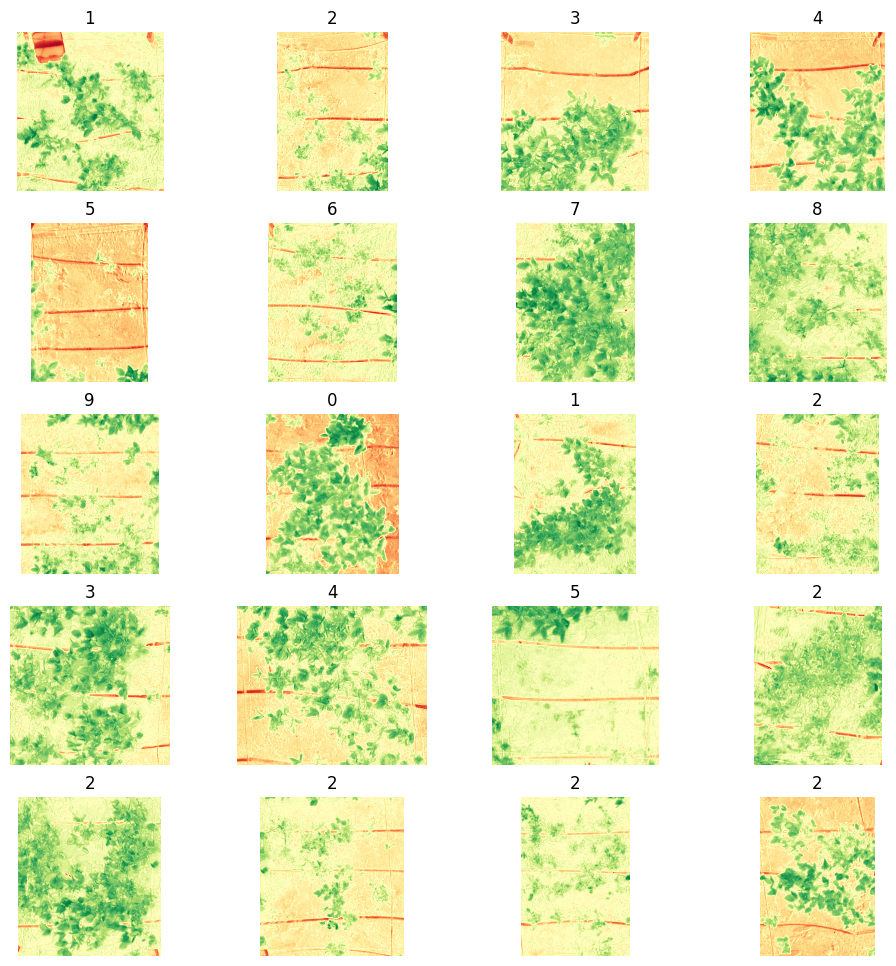

In [ ]:

titulos = [1,2,3,4,5,6,7,8,9,0,1,2,3,4,5,2,2,2,2,2]
pimp.grafica_parcelas(parcelas = parcelas_ndvi, titulos= titulos, tipo="ndvi", num_filas=5, num_columnas=4, figsize=(12, 12))

## Correlación

Se definen dos listas, $\texttt{x}$ e $\texttt{y}$ que contienen valores numéricos de variables in-situ en este caso.
Se imprime la longitud de las listas x e y con  la función $\texttt{print()}$ para verificar que ambas listas tienen la misma longitud.
Al llamar al método $\texttt{filtrar_pixeles()}$ de la instancia pimp de la clase PIMP, pasando como argumentos la lista de parcelas NDVI, las listas x e y, y el umbral de filtrado (0.2). Esto filtra los píxeles de cada parcela NDVI según el umbral especificado y calcula estadísticas adicionales (**Media Aritmética** de los valores de pixeles mayores a 0.3 y **Desviación Media Absoluta** de estos mismos valores) para cada imagen NDVI.
El resultado será un DataFrame llamado $\texttt{resultados}$ que contendrá la cantidad de píxeles filtrados y las estadísticas adicionales calculadas para cada imagen NDVI, junto con las variables x e y si se proporcionan.


**Recordar que todas las variables deben tener igual longitud para la ejecución correcta**


In [ ]:
x= [14.43 , 11.93 , 19.83, 16.00, 6.14, 7.67, 24.72, 18.47, 12.32, 20.59, 20.27, 9.33, 16.25, 11.29, 2.83, 29.08, 26.84, 11.40, 17.57, 14.24]
y= [1.65, 1.07, 2.27, 2.46, 0.53, 0.64, 3.46, 1.89, 1.35, 3.35, 3.15, 1.07, 2.45, 1.44, 0.17, 2.88, 3.61, 1.08, 1.39, 2.20]

print(len(x))
print(len(y))
resultados = pimp.filtrar_pixeles(parcelas_ndvi, x=x,y=y, umbral=0.2)

20
20


El método $\texttt{graficar_correlacion()}$ genera y grafica la matriz de correlación entre las variables del DataFrame $\texttt{resultados}$ utilizando la biblioteca Seaborn. La matriz de correlación muestra la relación entre todas las variables del DataFrame, incluidas las variables x e y si están presentes. Las celdas de la matriz de correlación están coloreadas según el valor de correlación, lo que facilita la identificación de patrones y relaciones entre las variables.


**Recordar que todas las variables deben tener igual longitud para la ejecución correcta**


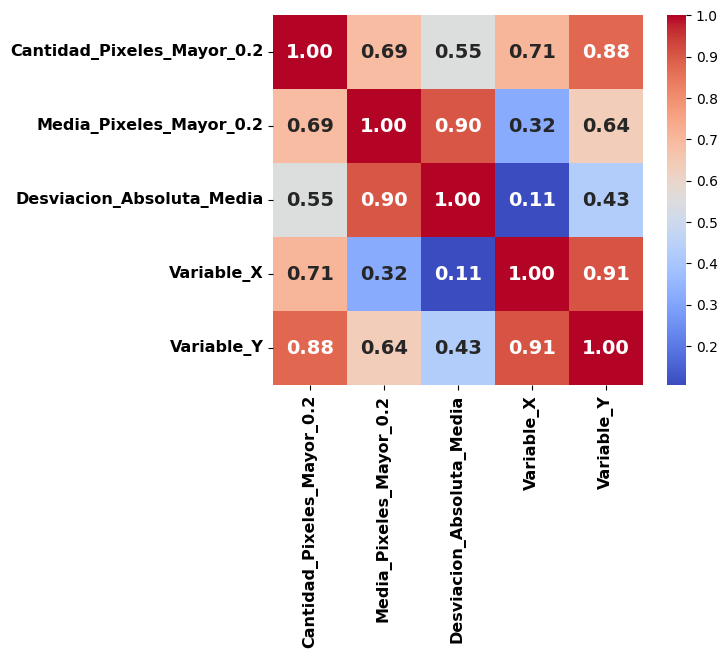

In [ ]:
pimp.graficar_correlacion(resultados)